<a href="https://colab.research.google.com/github/ykitaguchi77/GravCont_classification_colab/blob/master/Hertel_region-based-attention-visualiation.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

#**Hertel estimation_判断根拠の可視化**

In [1]:
#@title Import modules
from __future__ import print_function, division
!pip install --q torch_optimizer

import torch
import torch.nn as nn
import torch_optimizer as optim
import torch.utils.data as data
import numpy as np
import pandas as pd
import torchvision
from torchvision import datasets, models, transforms
from torch.utils.data import Dataset, DataLoader
from torch.utils.data.dataset import Subset
from torchvision.io import read_image
import matplotlib.pyplot as plt
import re
import time
import os
import copy
import statistics
import math
from decimal import Decimal, ROUND_HALF_UP
import shutil
import codecs
from scipy import stats
from sklearn.model_selection import LeaveOneGroupOut
from sklearn.model_selection import StratifiedGroupKFold
from sklearn.model_selection import StratifiedKFold
from sklearn.model_selection import train_test_split
from sklearn.model_selection import KFold
!pip install --q pingouin
import pingouin as pg

import glob
import random
import json
from PIL import Image
from tqdm import tqdm
%matplotlib inline
import seaborn as sns; sns.set()


#サポートパッチのインポート
from google.colab.patches import cv2_imshow
import cv2

random_seed = 3 #shuffleのシード

plt.ion()   # interactive mode
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
!nvidia-smi

# Set random seem for reproducibility
manualSeed = 1234
#manualSeed = random.randint(1, 10000) # use if you want new results
print("Random Seed: ", manualSeed)
random.seed(manualSeed)
torch.manual_seed(manualSeed)
torch.cuda.manual_seed(manualSeed)

torch.torch.backends.cudnn.benchmark = True
torch.torch.backends.cudnn.enabled = True


#google driveをcolabolatoryにマウント
from google.colab import drive
drive.mount('/content/drive')

Thu Nov 24 11:51:25 2022       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 460.32.03    Driver Version: 460.32.03    CUDA Version: 11.2     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla T4            Off  | 00000000:00:04.0 Off |                    0 |
| N/A   43C    P8    10W /  70W |      3MiB / 15109MiB |      0%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

In [2]:
# example_path_list
glob.glob(f"/content/drive/MyDrive/発表/2022眼科AI学会/dataset_250px_uni_periocular/*")[0:5]


['/content/drive/MyDrive/発表/2022眼科AI学会/dataset_250px_uni_periocular/472_R.JPG',
 '/content/drive/MyDrive/発表/2022眼科AI学会/dataset_250px_uni_periocular/465_R.JPG',
 '/content/drive/MyDrive/発表/2022眼科AI学会/dataset_250px_uni_periocular/469_R.JPG',
 '/content/drive/MyDrive/発表/2022眼科AI学会/dataset_250px_uni_periocular/468_L.JPG',
 '/content/drive/MyDrive/発表/2022眼科AI学会/dataset_250px_uni_periocular/466_L.JPG']

In [3]:
#@title set parameters
area = 'eye' #@param ["half", "periocular", "eye"] {allow-input: true}
patient = 468#@param {type:"number"} {allow-input: true}
side = 'R' #@param ["R", "L"] {allow-input: true}

DATASET_PATH = f"/content/drive/MyDrive/発表/2022眼科AI学会/dataset_250px_uni_{area}/{patient}_{side}.JPG"
model_path =f"/content/drive/MyDrive/発表/2022眼科AI学会/models_Hertel_estimation/5-fold-crossvalidation/{area}_fold0_RepVGGA2.pth"
csv_path = f"/content/drive/MyDrive/発表/2022眼科AI学会/Hertel_unilateral.csv"

PX = 224
TRAIN_NORMALIZE_PARAM = [0.485, 0.456, 0.406], [0.229, 0.224, 0.225]
ROTATION_DEGREES = 3
TRAIN_CROP_SCALE =(0.75,1.0)
VAL_NORMALIZE_PARAM = [0.485, 0.456, 0.406], [0.229, 0.224, 0.225]


train_data_transforms = nn.Sequential(
                transforms.RandomResizedCrop(PX, scale=TRAIN_CROP_SCALE),
                #transforms.RandomRotation(ROTATION_DEGREES),
                transforms.RandomHorizontalFlip(),
                transforms.ConvertImageDtype(torch.float32),
                transforms.Normalize(TRAIN_NORMALIZE_PARAM[0], TRAIN_NORMALIZE_PARAM[1])
                ).to(device)
val_data_transforms = nn.Sequential(
                transforms.Resize(PX),
                transforms.ConvertImageDtype(torch.float32),
                transforms.Normalize(VAL_NORMALIZE_PARAM[0], VAL_NORMALIZE_PARAM[1])
                ).to(device)

def my_round(x, d=2):
    p = 10 ** d
    return float(math.floor((x * p) + math.copysign(0.5, x)))/p

In [4]:
#@title Create datasets
################
# Create datasets #
################

class Create_Datasets(Dataset):
     
    def __init__(self, image_path_list_list, idxs, csv_path, transform):
        self.transform = transform
        self.path_list_list = path_list_list
        self.idxs = idxs
        self.item_paths = []
        self.item_dict = {}
        self.df = pd.read_csv(csv_path)
        df = self.df

        k=0
        for idx in idxs:
            path_0, path_1, path_2 = path_list_list[0][idx], path_list_list[1][idx], path_list_list[2][idx]
            base_name = os.path.splitext(os.path.basename(path_0))[0] #フォルダより画像番号を抜き出す
            hertel = df[df['number']==str(base_name)].iloc[0,1] #CSV上で一致した番号の画像についてHertel値を抜き出す
            self.item_paths.append([path_0, path_1, path_2, hertel]) #[path, hertel]の組み合わせをリストに追加する
            item_paths = self.item_paths
 
    def __len__(self):
        return len(self.item_paths)
     
    def __getitem__(self, index):
        # [tensor[path0, path1, path2], hertel_value]
        def tensor_img(image_path):
            pilr_image = Image.open(image_path).convert("RGB")
            tensor_image = transforms.functional.to_tensor(pilr_image)
            tensor_image = self.transform(tensor_image)
            # tensor_image = self.transform(pilr_image).float()
            # tensor_image = self.transform(read_image(path=image_path))
            return tensor_image
        tensor_image_0 = tensor_img(self.item_paths[index][0]) 
        tensor_image_1 = tensor_img(self.item_paths[index][1])      
        tensor_image_2 = tensor_img(self.item_paths[index][2])      
        tensor_image = torch.stack([tensor_image_0, tensor_image_1, tensor_image_2])
        #tensor_image = tensor_image_0
        hertel = self.item_paths[index][3]
        target= torch.tensor([hertel]).float()
        return  tensor_image, target


######################
# Test with early stopping #
######################

class EarlyStopping:
    """Early stops the training if validation loss doesn't improve after a given patience."""
    def __init__(self, patience=7, verbose=False, delta=0, path='checkpoint.pt', trace_func=print):
        """
        Args:
            patience (int): How long to wait after last time validation loss improved.
                            Default: 7
            verbose (bool): If True, prints a message for each validation loss improvement. 
                            Default: False
            delta (float): Minimum change in the monitored quantity to qualify as an improvement.
                            Default: 0
            path (str): Path for the checkpoint to be saved to.
                            Default: 'checkpoint.pt'
            trace_func (function): trace print function.
                            Default: print            
        """
        self.patience = patience
        self.verbose = verbose
        self.counter = 0
        self.best_score = None
        self.early_stop = False
        self.val_loss_min = np.Inf
        self.delta = delta
        self.path = path
        self.trace_func = trace_func
    def __call__(self, val_loss, model):

        score = -val_loss

        if self.best_score is None:
            self.best_score = score
            self.save_checkpoint(val_loss, model)
        elif score < self.best_score + self.delta:
            self.counter += 1
            self.trace_func(f'EarlyStopping counter: {self.counter} out of {self.patience}')
            if self.counter >= self.patience:
                self.early_stop = True
        else:
            self.best_score = score
            self.save_checkpoint(val_loss, model)
            self.counter = 0

    def save_checkpoint(self, val_loss, model):
        '''Saves model when validation loss decrease.'''
        if self.verbose:
            self.trace_func(f'Validation loss decreased ({self.val_loss_min:.6f} --> {val_loss:.6f}).  Saving model ...')
        torch.save(model.state_dict(), self.path)
        self.val_loss_min = val_loss


#1つずつ解析するバージョン
def train_model(model, loss_func, batch_size, optimizer, patience, n_epochs, device, area_num, alpha=0):
    
    # to track the training loss as the model trains
    train_losses = []
    # to track the validation loss as the model trains
    valid_losses = []
    # to track the average training loss per epoch as the model trains
    avg_train_losses = []
    # to track the average validation loss per epoch as the model trains
    avg_valid_losses = [] 
    
    # initialize the early_stopping object
    early_stopping = EarlyStopping(patience=patience, verbose=True)

    for epoch in range(1, n_epochs + 1):

        ###################
        # train the model #
        ###################
        model.train() # prep model for training

        running_corrects, train_acc= 0, 0

        # define scaler for fastening
        scaler = torch.cuda.amp.GradScaler() 

        for batch, (image_tensor, target) in enumerate(train_loader, 1):
            # convert batch-size labels to batch-size x 1 tensor
            #target = target.squeeze(1)
            target = target.view(len(target), 1)

            image_tensor = image_tensor.to(device)
            target = target.to(device)

            # clear the gradients of all optimized variables
            optimizer.zero_grad()
            # forward pass: compute predicted outputs by passing inputs to the model
            output = model(image_tensor[:,area_num])  #16,3,3,224,224 --> 16,3,224,224 (バッチサイズの次の次元でスライスすることによりtensorを取り出す)
            # calculate the loss
            with torch.cuda.amp.autocast(): 
                loss = loss_func(output, target)

                ################
                ##l2_normalization##
                ################
                l2 = torch.tensor(0., requires_grad=True)
                for w in model.parameters():
                    l2 = l2 + torch.norm(w)**2
                loss = loss + alpha*l2

            # backward pass: compute gradient of the loss with respect to model parameters
            scaler.scale(loss).backward()
            # perform a single optimization step (parameter update)
            scaler.step(optimizer) 
            scaler.update() 

            # record training loss
            train_losses.append(loss.item())


        ######################    
        # validate the model #
        ######################
       
        model.eval() # prep model for evaluation

        running_corrects, val_acc= 0, 0

        for image_tensor, target in val_loader:  
            #target = target.squeeze(1)         
            target = target.view(len(target), 1)

            image_tensor = image_tensor.to(device)
            target = target.to(device)
            # forward pass: compute predicted outputs by passing inputs to the model
            output = model(image_tensor[:,area_num])
            # calculate the loss
            loss = loss_func(output, target)
            # record validation loss
            valid_losses.append(loss.item())

        # print training/validation statistics 
        # calculate average loss over an epoch
        train_loss = np.average(train_losses)
        valid_loss = np.average(valid_losses)
        avg_train_losses.append(train_loss)
        avg_valid_losses.append(valid_loss)
        
        epoch_len = len(str(n_epochs))
        
        print_msg = (f'Epoch: [{epoch:>{epoch_len}}/{n_epochs:>{epoch_len}}] ' +'\n'
                     f'train_loss: {train_loss:.5f} ' +'\n'
                     f'valid_loss: {valid_loss:.5f} ' )
        
        print(print_msg)

        
        #Scheduler step for SGD
        #scheduler.step() #val_lossが下がらなければ減衰
        

        # clear lists to track next epoch
        train_losses = []
        valid_losses = []
        
        # early_stopping needs the validation loss to check if it has decresed, 
        # and if it has, it will make a checkpoint of the current model
        early_stopping(valid_loss, model)
        
        if early_stopping.early_stop:
            print("Early stopping")
            break
        
        print('')

    # load the last checkpoint with the best model
    model.load_state_dict(torch.load('checkpoint.pt'))

    return  model, avg_train_losses, avg_valid_losses

In [5]:
#@title Define RepVGG-A2
##################
# Define RepVGG-A2 #
##################

def conv_bn(in_channels, out_channels, kernel_size, stride, padding, groups=1):
    result = nn.Sequential()
    result.add_module('conv', nn.Conv2d(in_channels=in_channels, out_channels=out_channels,
                                                  kernel_size=kernel_size, stride=stride, padding=padding, groups=groups, bias=False))
    result.add_module('bn', nn.BatchNorm2d(num_features=out_channels))
    return result

class RepVGGBlock(nn.Module):

    def __init__(self, in_channels, out_channels, kernel_size,
                 stride=1, padding=0, dilation=1, groups=1, padding_mode='zeros', deploy=False):
        super(RepVGGBlock, self).__init__()
        self.deploy = deploy
        self.groups = groups
        self.in_channels = in_channels

        assert kernel_size == 3
        assert padding == 1

        padding_11 = padding - kernel_size // 2

        self.nonlinearity = nn.ReLU()

        if deploy:
            self.rbr_reparam = nn.Conv2d(in_channels=in_channels, out_channels=out_channels, kernel_size=kernel_size, stride=stride,
                                      padding=padding, dilation=dilation, groups=groups, bias=True, padding_mode=padding_mode)

        else:
            self.rbr_identity = nn.BatchNorm2d(num_features=in_channels) if out_channels == in_channels and stride == 1 else None
            self.rbr_dense = conv_bn(in_channels=in_channels, out_channels=out_channels, kernel_size=kernel_size, stride=stride, padding=padding, groups=groups)
            self.rbr_1x1 = conv_bn(in_channels=in_channels, out_channels=out_channels, kernel_size=1, stride=stride, padding=padding_11, groups=groups)
            print('RepVGG Block, identity = ', self.rbr_identity)


    def forward(self, inputs):
        if hasattr(self, 'rbr_reparam'):
            return self.nonlinearity(self.rbr_reparam(inputs))

        if self.rbr_identity is None:
            id_out = 0
        else:
            id_out = self.rbr_identity(inputs)

        return self.nonlinearity(self.rbr_dense(inputs) + self.rbr_1x1(inputs) + id_out)



#   This func derives the equivalent kernel and bias in a DIFFERENTIABLE way.
#   You can get the equivalent kernel and bias at any time and do whatever you want,
    #   for example, apply some penalties or constraints during training, just like you do to the other models.
#   May be useful for quantization or pruning.
    def get_equivalent_kernel_bias(self):
        kernel3x3, bias3x3 = self._fuse_bn_tensor(self.rbr_dense)
        kernel1x1, bias1x1 = self._fuse_bn_tensor(self.rbr_1x1)
        kernelid, biasid = self._fuse_bn_tensor(self.rbr_identity)
        return kernel3x3 + self._pad_1x1_to_3x3_tensor(kernel1x1) + kernelid, bias3x3 + bias1x1 + biasid

    def _pad_1x1_to_3x3_tensor(self, kernel1x1):
        if kernel1x1 is None:
            return 0
        else:
            return torch.nn.functional.pad(kernel1x1, [1,1,1,1])

    def _fuse_bn_tensor(self, branch):
        if branch is None:
            return 0, 0
        if isinstance(branch, nn.Sequential):
            kernel = branch.conv.weight
            running_mean = branch.bn.running_mean
            running_var = branch.bn.running_var
            gamma = branch.bn.weight
            beta = branch.bn.bias
            eps = branch.bn.eps
        else:
            assert isinstance(branch, nn.BatchNorm2d)
            if not hasattr(self, 'id_tensor'):
                input_dim = self.in_channels // self.groups
                kernel_value = np.zeros((self.in_channels, input_dim, 3, 3), dtype=np.float32)
                for i in range(self.in_channels):
                    kernel_value[i, i % input_dim, 1, 1] = 1
                self.id_tensor = torch.from_numpy(kernel_value).to(branch.weight.device)
            kernel = self.id_tensor
            running_mean = branch.running_mean
            running_var = branch.running_var
            gamma = branch.weight
            beta = branch.bias
            eps = branch.eps
        std = (running_var + eps).sqrt()
        t = (gamma / std).reshape(-1, 1, 1, 1)
        return kernel * t, beta - running_mean * gamma / std

    def repvgg_convert(self):
        kernel, bias = self.get_equivalent_kernel_bias()
        return kernel.detach().cpu().numpy(), bias.detach().cpu().numpy(),



class RepVGG(nn.Module):

    def __init__(self, num_blocks, num_classes=1000, width_multiplier=None, override_groups_map=None, deploy=False):
        super(RepVGG, self).__init__()

        assert len(width_multiplier) == 4

        self.deploy = deploy
        self.override_groups_map = override_groups_map or dict()

        assert 0 not in self.override_groups_map

        self.in_planes = min(64, int(64 * width_multiplier[0]))

        self.stage0 = RepVGGBlock(in_channels=3, out_channels=self.in_planes, kernel_size=3, stride=2, padding=1, deploy=self.deploy)
        self.cur_layer_idx = 1
        self.stage1 = self._make_stage(int(64 * width_multiplier[0]), num_blocks[0], stride=2)
        self.stage2 = self._make_stage(int(128 * width_multiplier[1]), num_blocks[1], stride=2)
        self.stage3 = self._make_stage(int(256 * width_multiplier[2]), num_blocks[2], stride=2)
        self.stage4 = self._make_stage(int(512 * width_multiplier[3]), num_blocks[3], stride=2)
        self.gap = nn.AdaptiveAvgPool2d(output_size=1)
        self.linear = nn.Linear(int(512 * width_multiplier[3]), num_classes)


    def _make_stage(self, planes, num_blocks, stride):
        strides = [stride] + [1]*(num_blocks-1)
        blocks = []
        for stride in strides:
            cur_groups = self.override_groups_map.get(self.cur_layer_idx, 1)
            blocks.append(RepVGGBlock(in_channels=self.in_planes, out_channels=planes, kernel_size=3,
                                      stride=stride, padding=1, groups=cur_groups, deploy=self.deploy))
            self.in_planes = planes
            self.cur_layer_idx += 1
        return nn.Sequential(*blocks)

    def forward(self, x):
        out = self.stage0(x)
        out = self.stage1(out)
        out = self.stage2(out)
        out = self.stage3(out)
        out = self.stage4(out)
        out = self.gap(out)
        out = out.view(out.size(0), -1)
        out = self.linear(out)
        return out


optional_groupwise_layers = [2, 4, 6, 8, 10, 12, 14, 16, 18, 20, 22, 24, 26]
g2_map = {l: 2 for l in optional_groupwise_layers}
g4_map = {l: 4 for l in optional_groupwise_layers}

def create_RepVGG_A0(deploy=False):
    return RepVGG(num_blocks=[2, 4, 14, 1], num_classes=1000,
                  width_multiplier=[0.75, 0.75, 0.75, 2.5], override_groups_map=None, deploy=deploy)

def create_RepVGG_A1(deploy=False):
    return RepVGG(num_blocks=[2, 4, 14, 1], num_classes=1000,
                  width_multiplier=[1, 1, 1, 2.5], override_groups_map=None, deploy=deploy)

def create_RepVGG_A2(deploy=False):
    return RepVGG(num_blocks=[2, 4, 14, 1], num_classes=1000,
                  width_multiplier=[1.5, 1.5, 1.5, 2.75], override_groups_map=None, deploy=deploy)

def create_RepVGG_B0(deploy=False):
    return RepVGG(num_blocks=[4, 6, 16, 1], num_classes=1000,
                  width_multiplier=[1, 1, 1, 2.5], override_groups_map=None, deploy=deploy)

def create_RepVGG_B1(deploy=False):
    return RepVGG(num_blocks=[4, 6, 16, 1], num_classes=1000,
                  width_multiplier=[2, 2, 2, 4], override_groups_map=None, deploy=deploy)

def create_RepVGG_B1g2(deploy=False):
    return RepVGG(num_blocks=[4, 6, 16, 1], num_classes=1000,
                  width_multiplier=[2, 2, 2, 4], override_groups_map=g2_map, deploy=deploy)

def create_RepVGG_B1g4(deploy=False):
    return RepVGG(num_blocks=[4, 6, 16, 1], num_classes=1000,
                  width_multiplier=[2, 2, 2, 4], override_groups_map=g4_map, deploy=deploy)


def create_RepVGG_B2(deploy=False):
    return RepVGG(num_blocks=[4, 6, 16, 1], num_classes=1000,
                  width_multiplier=[2.5, 2.5, 2.5, 5], override_groups_map=None, deploy=deploy)

def create_RepVGG_B2g2(deploy=False):
    return RepVGG(num_blocks=[4, 6, 16, 1], num_classes=1000,
                  width_multiplier=[2.5, 2.5, 2.5, 5], override_groups_map=g2_map, deploy=deploy)

def create_RepVGG_B2g4(deploy=False):
    return RepVGG(num_blocks=[4, 6, 16, 1], num_classes=1000,
                  width_multiplier=[2.5, 2.5, 2.5, 5], override_groups_map=g4_map, deploy=deploy)


def create_RepVGG_B3(deploy=False):
    return RepVGG(num_blocks=[4, 6, 16, 1], num_classes=1000,
                  width_multiplier=[3, 3, 3, 5], override_groups_map=None, deploy=deploy)

def create_RepVGG_B3g2(deploy=False):
    return RepVGG(num_blocks=[4, 6, 16, 1], num_classes=1000,
                  width_multiplier=[3, 3, 3, 5], override_groups_map=g2_map, deploy=deploy)

def create_RepVGG_B3g4(deploy=False):
    return RepVGG(num_blocks=[4, 6, 16, 1], num_classes=1000,
                  width_multiplier=[3, 3, 3, 5], override_groups_map=g4_map, deploy=deploy)


func_dict = {
'RepVGG-A0': create_RepVGG_A0,
'RepVGG-A1': create_RepVGG_A1,
'RepVGG-A2': create_RepVGG_A2,
'RepVGG-B0': create_RepVGG_B0,
'RepVGG-B1': create_RepVGG_B1,
'RepVGG-B1g2': create_RepVGG_B1g2,
'RepVGG-B1g4': create_RepVGG_B1g4,
'RepVGG-B2': create_RepVGG_B2,
'RepVGG-B2g2': create_RepVGG_B2g2,
'RepVGG-B2g4': create_RepVGG_B2g4,
'RepVGG-B3': create_RepVGG_B3,
'RepVGG-B3g2': create_RepVGG_B3g2,
'RepVGG-B3g4': create_RepVGG_B3g4,
}
def get_RepVGG_func_by_name(name):
    return func_dict[name]



#   Use this for converting a customized model with RepVGG as one of its components (e.g., the backbone of a semantic segmentation model)
#   The use case will be like
#   1.  Build train_model. For example, build a PSPNet with a training-time RepVGG as backbone
#   2.  Train train_model or do whatever you want
#   3.  Build deploy_model. In the above example, that will be a PSPNet with an inference-time RepVGG as backbone
#   4.  Call this func
#   ====================== the pseudo code will be like
#   train_backbone = create_RepVGG_B2(deploy=False)
#   train_backbone.load_state_dict(torch.load('RepVGG-B2-train.pth'))
#   train_pspnet = build_pspnet(backbone=train_backbone)
#   segmentation_train(train_pspnet)
#   deploy_backbone = create_RepVGG_B2(deploy=True)
#   deploy_pspnet = build_pspnet(backbone=deploy_backbone)
#   whole_model_convert(train_pspnet, deploy_pspnet)
#   segmentation_test(deploy_pspnet)
def whole_model_convert(train_model:torch.nn.Module, deploy_model:torch.nn.Module, save_path=None):
    all_weights = {}
    for name, module in train_model.named_modules():
        if hasattr(module, 'repvgg_convert'):
            kernel, bias = module.repvgg_convert()
            all_weights[name + '.rbr_reparam.weight'] = kernel
            all_weights[name + '.rbr_reparam.bias'] = bias
            print('convert RepVGG block')
        else:
            for p_name, p_tensor in module.named_parameters():
                full_name = name + '.' + p_name
                if full_name not in all_weights:
                    all_weights[full_name] = p_tensor.detach().cpu().numpy()
            for p_name, p_tensor in module.named_buffers():
                full_name = name + '.' + p_name
                if full_name not in all_weights:
                    all_weights[full_name] = p_tensor.cpu().numpy()

    deploy_model.load_state_dict(all_weights)
    if save_path is not None:
        torch.save(deploy_model.state_dict(), save_path)

    return deploy_model


#   Use this when converting a RepVGG without customized structures.
#   train_model = create_RepVGG_A0(deploy=False)
#   train train_model
#   deploy_model = repvgg_convert(train_model, create_RepVGG_A0, save_path='repvgg_deploy.pth')
def repvgg_model_convert(model:torch.nn.Module, build_func, save_path=None):
    converted_weights = {}
    for name, module in model.named_modules():
        if hasattr(module, 'repvgg_convert'):
            kernel, bias = module.repvgg_convert()
            converted_weights[name + '.rbr_reparam.weight'] = kernel
            converted_weights[name + '.rbr_reparam.bias'] = bias
        elif isinstance(module, torch.nn.Linear):
            converted_weights[name + '.weight'] = module.weight.detach().cpu().numpy()
            converted_weights[name + '.bias'] = module.bias.detach().cpu().numpy()
    del model

    deploy_model = build_func(deploy=True)
    for name, param in deploy_model.named_parameters():
        print('deploy param: ', name, param.size(), np.mean(converted_weights[name]))
        param.data = torch.from_numpy(converted_weights[name]).float()

    if save_path is not None:
        torch.save(deploy_model.state_dict(), save_path)

    return deploy_model





class mod_RepVGG(nn.Module):
    def __init__(self):
        super(mod_RepVGG, self).__init__()
        repVGG = model_ft
        self.repVGG = nn.Sequential(*list(model_ft.children())[:-1])
        self.dropout = nn.Dropout(0.25) #Define proportion or neurons to dropout
        self.fc = nn.Linear(in_features=1408, out_features=1) #out_featuresを1に

    def forward(self, x):
        x = self.repVGG(x)
        x = torch.flatten(x, 1)
        x = self.dropout(x) #dropoutを1層追加
        x = self.fc(x)
        return x

In [8]:
#@title ここはskip
# # Interference several images
# %matplotlib inline

# ###########################
# # ここを入力する！
# image_number = 0
# ###########################


# #Datasetの読み込み
# image_path_list = glob.glob(f"{DATASET_PATH}/*")[image_number:image_number+1]
# csv_path = csv_path

# #ラベルの読み込み
# with codecs.open(csv_path, "r", "Shift-JIS", "ignore") as file:
#         df = pd.read_csv(file, index_col=None, header=0)

# targets, outputs = [], []
# for path in image_path_list:
#     print(path)
#     base_name = os.path.splitext(os.path.basename(path))[0] #フォルダより画像番号を抜き出す
#     hertel = df[df['number']==str(base_name)].iloc[0,1] #CSV上で一致した番号の画像についてHertel値を抜き出す
#     targets.append(hertel) 


# #評価のための画像下処理
# def image_transform(image_path):    
#     image=Image.open(image_path)
#     transform = transforms.Compose([
#             transforms.Resize(256),
#             transforms.CenterCrop(224),
#             transforms.ToTensor(),
#             transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225])])
#     image_tensor = transform(image)
#     #バッチサイズの次元を先頭に追加した4Dテンソルに変換
#     image_tensor.unsqueeze_(0)
#     #print(image_tensor.size())  # torch.Size([1, 3, 224, 224])
#     image_tensor = image_tensor.to(device) #model_ftをGPUに載せる
#     return(image_tensor)

# #Interference
# model_ft = create_RepVGG_A2(deploy=False) 
# model_ft = mod_RepVGG()
# model_ft = model_ft.to(device)
# model_ft.load_state_dict(torch.load(model_path))
# model_ft.eval() # prep model for evaluation
# print(f"model_path: {model_path}")
 
# for img in image_path_list:
#       Image.register_open
#       with torch.inference_mode():
#           image_tensor = image_transform(img)  
#           # forward pass: compute predicted outputs by passing inputs to the model
#           outputs.append(model_ft(image_tensor).item()) 

# for path, target, output in zip(image_path_list, targets, outputs):
#     imgPIL = Image.open(path)  # 画像読み込み
#     plt.imshow(imgPIL)
#     plt.axis("off")
#     plt.show()
#     print(f"target: {target}, output: {output}")

RepVGG Block, identity =  None
RepVGG Block, identity =  None
RepVGG Block, identity =  BatchNorm2d(96, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
RepVGG Block, identity =  None
RepVGG Block, identity =  BatchNorm2d(192, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
RepVGG Block, identity =  BatchNorm2d(192, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
RepVGG Block, identity =  BatchNorm2d(192, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
RepVGG Block, identity =  None
RepVGG Block, identity =  BatchNorm2d(384, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
RepVGG Block, identity =  BatchNorm2d(384, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
RepVGG Block, identity =  BatchNorm2d(384, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
RepVGG Block, identity =  BatchNorm2d(384, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
RepVGG Block, identit

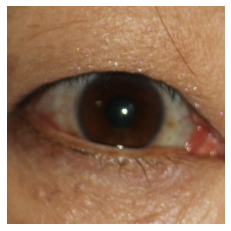

target: [17.0], output: [16.644662857055664]


In [6]:
from PIL import Image, ImageDraw
image = Image.open(DATASET_PATH)
image = image.resize((224, 224))

#ラベルの読み込み
with codecs.open(csv_path, "r", "Shift-JIS", "ignore") as file:
        df = pd.read_csv(file, index_col=None, header=0)

targets = []
base_name = os.path.splitext(os.path.basename(DATASET_PATH))[0] #フォルダより画像番号を抜き出す
hertel = df[df['number']==str(base_name)].iloc[0,1] #CSV上で一致した番号の画像についてHertel値を抜き出す
targets.append(hertel) 

def randmask(image):
    coordinates = np.sort(np.random.randint(0,225, (2,2)))

    while np.all(coordinates[:,1]-coordinates[:,0] > 50) == False: #幅が50pix未満の場合は設定し直す
        coordinates = np.sort(np.random.randint(0,225, (2,2)))
    x1 = coordinates[0,0]
    y1 = coordinates[1,0]
    x2 = coordinates[0,1]
    y2 = coordinates[1,1]

    # image_1 = image.copy()
    # rect_d = ImageDraw.Draw(image_1)
    # rect_d.rectangle(
    #     [(x1, y1), (x2, y2)], fill=(0, 0, 0)
    # )

    black = Image.new('RGB', (224, 224), 0)
    mask = Image.new("L", (224,224), 0)
    draw = ImageDraw.Draw(mask)
    draw.rectangle([(x1, y1), (x2, y2)], fill=255)
    image_1 = Image.composite(black, image, mask)
    image_2 = Image.composite(image, black, mask)
    return image_1, image_2, [x1, y1, x2, y2] #PIL


#評価のための画像下処理
def image_transform(image):    
    transform = transforms.Compose([
            transforms.Resize(256),
            transforms.CenterCrop(224),
            transforms.ToTensor(),
            transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225])])
    image_tensor = transform(image)
    #バッチサイズの次元を先頭に追加した4Dテンソルに変換
    image_tensor.unsqueeze_(0)
    #print(image_tensor.size())  # torch.Size([1, 3, 224, 224])
    image_tensor = image_tensor.to(device) #model_ftをGPUに載せる
    return(image_tensor)


#Load model
model_ft = create_RepVGG_A2(deploy=False) 
model_ft = mod_RepVGG()
model_ft = model_ft.to(device)
model_ft.load_state_dict(torch.load(model_path))
model_ft.eval() # prep model for evaluation
print(f"model_path: {model_path}")

#消去なし画像のアウトプットを確認
orig_output = []
with torch.inference_mode():
    image_tensor = image_transform(image)  
    # forward pass: compute predicted outputs by passing inputs to the model
    orig_output.append(model_ft(image_tensor).item()) 

imgPIL = Image.open(DATASET_PATH)  # 画像読み込み
plt.imshow(imgPIL)
plt.axis("off")
plt.show()
print(f"target: {targets}, output: {orig_output}")

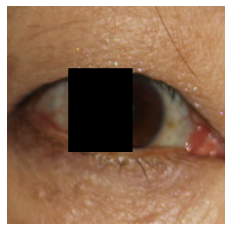

epoch 0
target: 17.0, output: 18.642229080200195
time: 0.2 sec


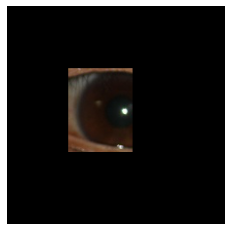

epoch 0
target: 17.0, output: 12.72758674621582
time: 0.3 sec



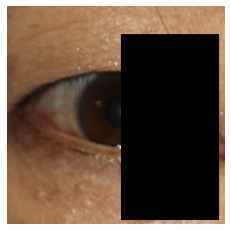

epoch 1
target: 17.0, output: 16.817110061645508
time: 0.5 sec


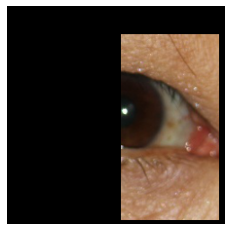

epoch 1
target: 17.0, output: 14.0035400390625
time: 0.6 sec



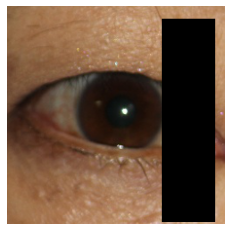

epoch 2
target: 17.0, output: 14.723012924194336
time: 0.8 sec


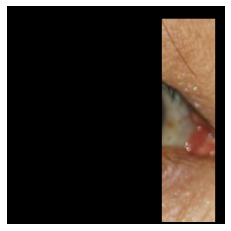

epoch 2
target: 17.0, output: 5.265902996063232
time: 0.9 sec



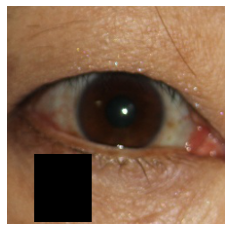

epoch 3
target: 17.0, output: 16.47620964050293
time: 1.1 sec


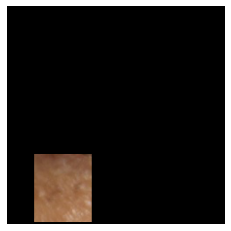

epoch 3
target: 17.0, output: 0.9515231251716614
time: 1.2 sec



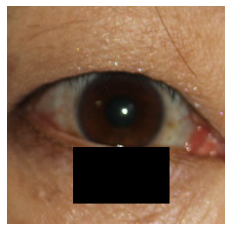

epoch 4
target: 17.0, output: 17.259357452392578
time: 1.4 sec


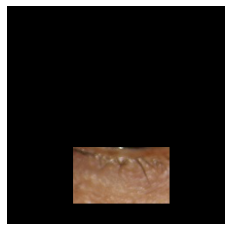

epoch 4
target: 17.0, output: 7.663747310638428
time: 1.5 sec



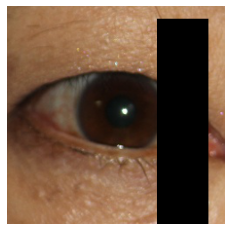

epoch 5
target: 17.0, output: 14.756595611572266
time: 1.7 sec


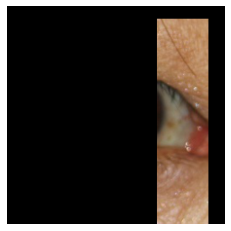

epoch 5
target: 17.0, output: 7.020263195037842
time: 1.8 sec



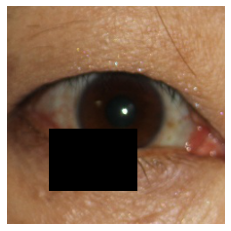

epoch 6
target: 17.0, output: 19.171724319458008
time: 2.0 sec


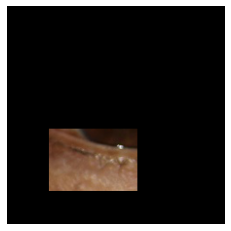

epoch 6
target: 17.0, output: 9.212864875793457
time: 2.3 sec



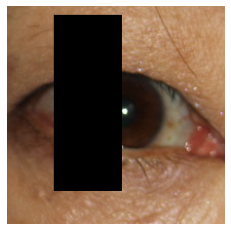

epoch 7
target: 17.0, output: 17.37470817565918
time: 2.4 sec


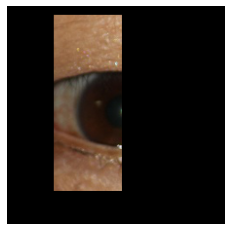

epoch 7
target: 17.0, output: 13.020784378051758
time: 2.6 sec



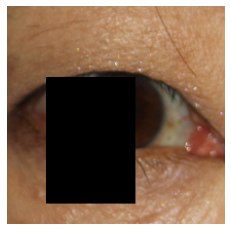

epoch 8
target: 17.0, output: 19.14063835144043
time: 2.8 sec


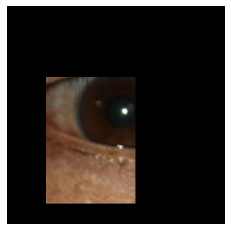

epoch 8
target: 17.0, output: 12.771198272705078
time: 2.9 sec



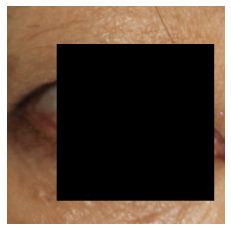

epoch 9
target: 17.0, output: 13.461715698242188
time: 3.0 sec


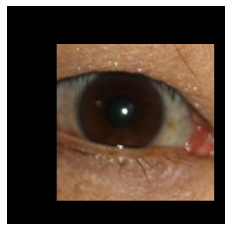

epoch 9
target: 17.0, output: 15.716577529907227
time: 3.2 sec

attention renewed!! (1)



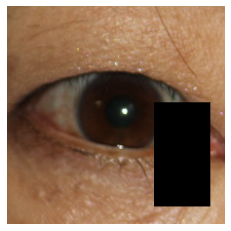

epoch 10
target: 17.0, output: 16.174894332885742
time: 3.4 sec


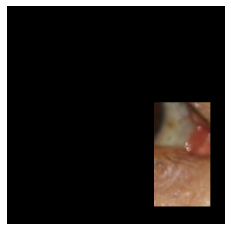

epoch 10
target: 17.0, output: 6.060730934143066
time: 3.5 sec



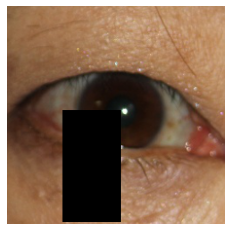

epoch 11
target: 17.0, output: 16.066120147705078
time: 3.7 sec


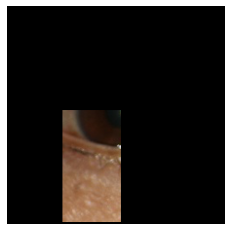

epoch 11
target: 17.0, output: 8.64521598815918
time: 3.8 sec



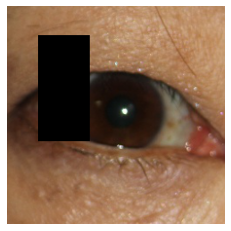

epoch 12
target: 17.0, output: 17.24517822265625
time: 4.0 sec


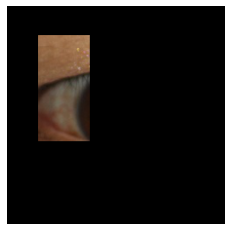

epoch 12
target: 17.0, output: 6.229715824127197
time: 4.2 sec



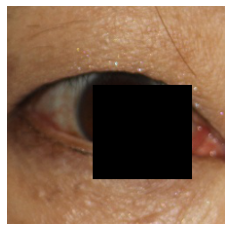

epoch 13
target: 17.0, output: 20.072078704833984
time: 4.3 sec


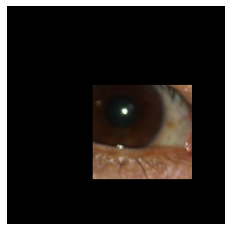

epoch 13
target: 17.0, output: 15.073539733886719
time: 4.5 sec

attention renewed!! (2)



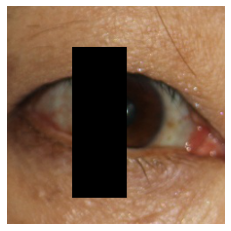

epoch 14
target: 17.0, output: 18.81609535217285
time: 4.6 sec


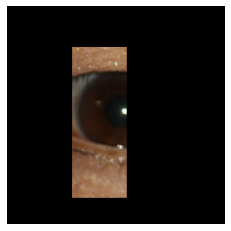

epoch 14
target: 17.0, output: 11.574694633483887
time: 4.8 sec



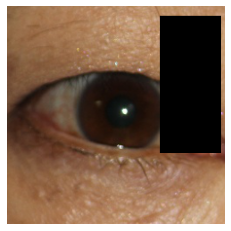

epoch 15
target: 17.0, output: 16.00896453857422
time: 5.0 sec


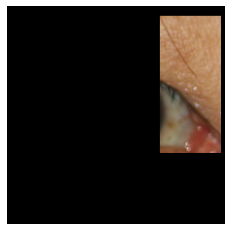

epoch 15
target: 17.0, output: 7.087817668914795
time: 5.1 sec



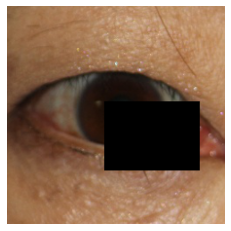

epoch 16
target: 17.0, output: 19.344785690307617
time: 5.3 sec


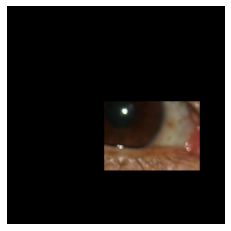

epoch 16
target: 17.0, output: 14.913318634033203
time: 5.4 sec

attention renewed!! (3)



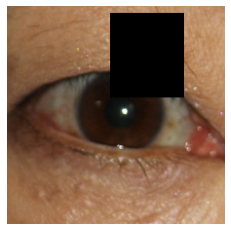

epoch 17
target: 17.0, output: 15.890000343322754
time: 5.6 sec


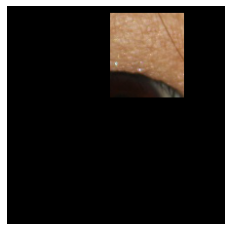

epoch 17
target: 17.0, output: 5.246939659118652
time: 5.7 sec



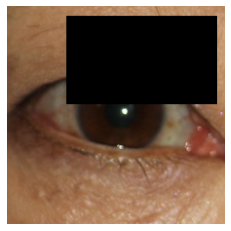

epoch 18
target: 17.0, output: 15.125243186950684
time: 5.9 sec


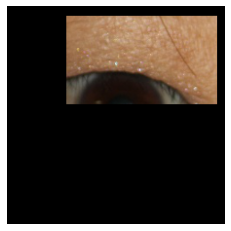

epoch 18
target: 17.0, output: 8.625551223754883
time: 6.0 sec



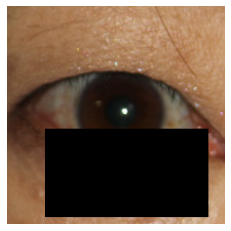

epoch 19
target: 17.0, output: 14.308636665344238
time: 6.2 sec


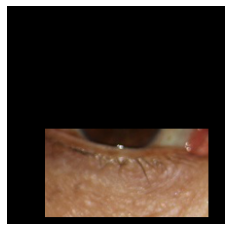

epoch 19
target: 17.0, output: 12.598325729370117
time: 6.3 sec



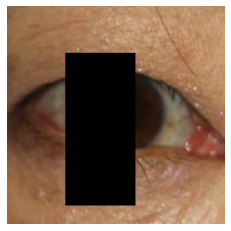

epoch 20
target: 17.0, output: 19.196229934692383
time: 6.5 sec


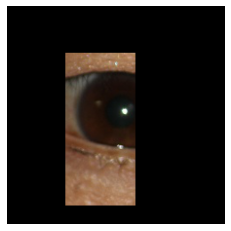

epoch 20
target: 17.0, output: 11.55496597290039
time: 6.7 sec



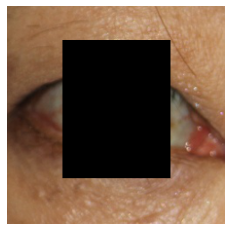

epoch 21
target: 17.0, output: 18.033554077148438
time: 6.8 sec


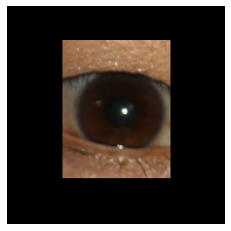

epoch 21
target: 17.0, output: 14.722524642944336
time: 7.0 sec



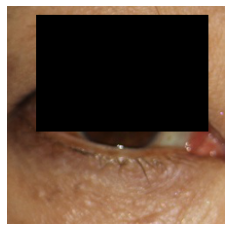

epoch 22
target: 17.0, output: 13.574198722839355
time: 7.1 sec


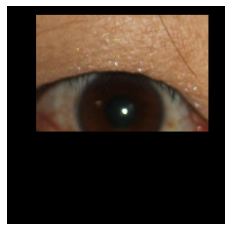

epoch 22
target: 17.0, output: 15.618680953979492
time: 7.3 sec

attention renewed!! (4)



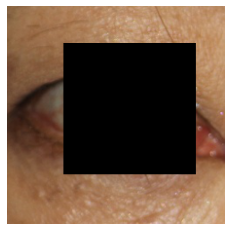

epoch 23
target: 17.0, output: 15.370750427246094
time: 7.5 sec


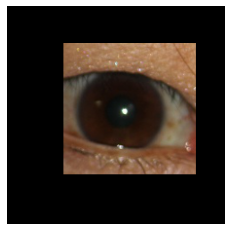

epoch 23
target: 17.0, output: 15.022151947021484
time: 7.6 sec



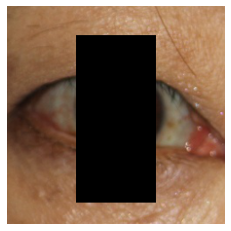

epoch 24
target: 17.0, output: 16.580371856689453
time: 7.8 sec


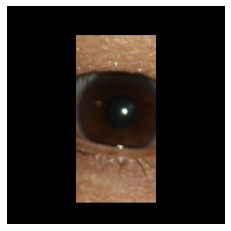

epoch 24
target: 17.0, output: 13.353179931640625
time: 8.1 sec



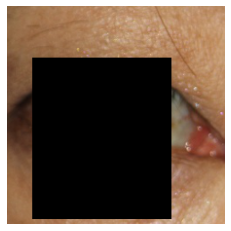

epoch 25
target: 17.0, output: 11.06405258178711
time: 8.2 sec


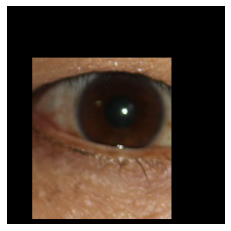

epoch 25
target: 17.0, output: 14.146018981933594
time: 8.4 sec

attention renewed!! (5)



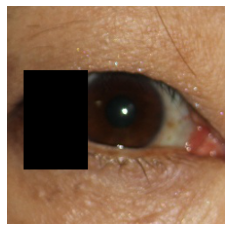

epoch 26
target: 17.0, output: 16.95400047302246
time: 8.6 sec


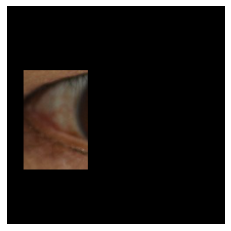

epoch 26
target: 17.0, output: 3.1695950031280518
time: 8.7 sec



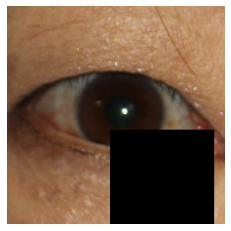

epoch 27
target: 17.0, output: 15.441702842712402
time: 8.9 sec


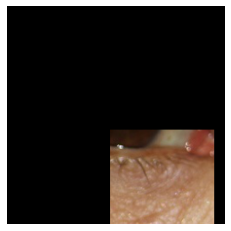

epoch 27
target: 17.0, output: 9.577595710754395
time: 9.0 sec



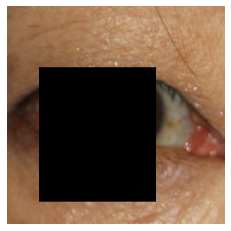

epoch 28
target: 17.0, output: 16.931903839111328
time: 9.2 sec


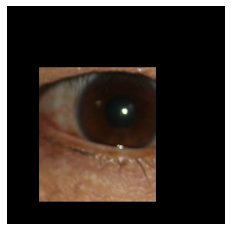

epoch 28
target: 17.0, output: 14.07266902923584
time: 9.3 sec



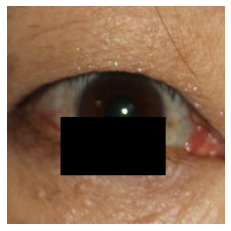

epoch 29
target: 17.0, output: 17.259477615356445
time: 9.5 sec


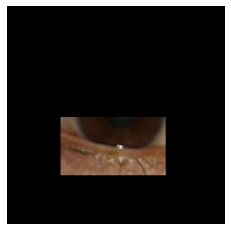

epoch 29
target: 17.0, output: 13.907147407531738
time: 9.6 sec



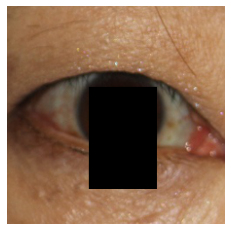

epoch 30
target: 17.0, output: 20.939035415649414
time: 9.8 sec


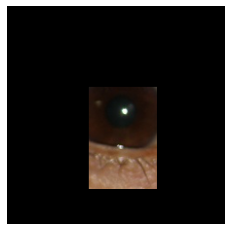

epoch 30
target: 17.0, output: 13.933348655700684
time: 9.9 sec

attention renewed!! (6)



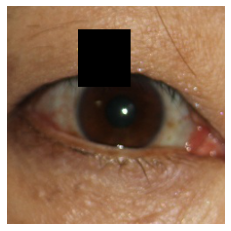

epoch 31
target: 17.0, output: 16.817575454711914
time: 10.1 sec


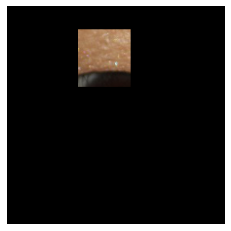

epoch 31
target: 17.0, output: 2.381481170654297
time: 10.2 sec



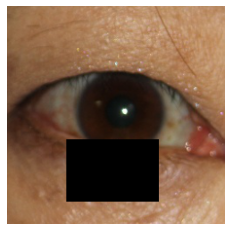

epoch 32
target: 17.0, output: 17.981950759887695
time: 10.4 sec


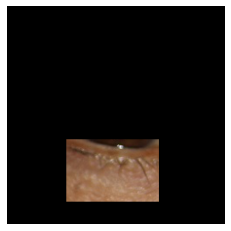

epoch 32
target: 17.0, output: 9.63682746887207
time: 10.5 sec



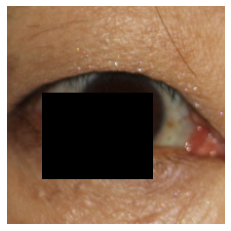

epoch 33
target: 17.0, output: 19.25591278076172
time: 10.7 sec


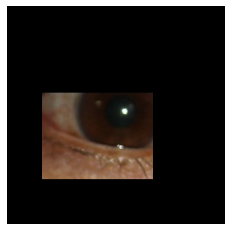

epoch 33
target: 17.0, output: 13.686395645141602
time: 10.9 sec



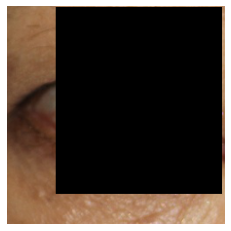

epoch 34
target: 17.0, output: 5.802110195159912
time: 11.0 sec


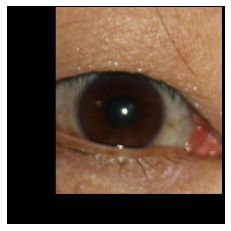

epoch 34
target: 17.0, output: 16.464242935180664
time: 11.2 sec

attention renewed!! (7)



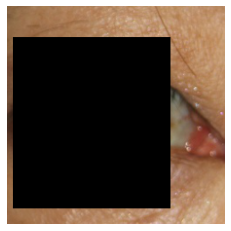

epoch 35
target: 17.0, output: 12.991449356079102
time: 11.3 sec


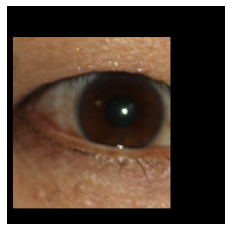

epoch 35
target: 17.0, output: 14.401126861572266
time: 11.5 sec

attention renewed!! (8)



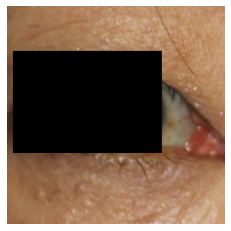

epoch 36
target: 17.0, output: 19.45029640197754
time: 11.6 sec


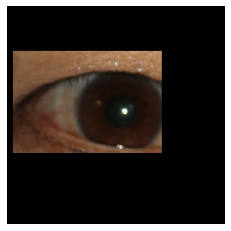

epoch 36
target: 17.0, output: 14.141050338745117
time: 11.8 sec

attention renewed!! (9)



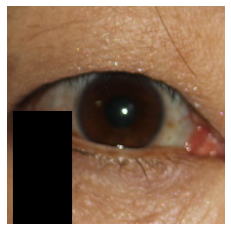

epoch 37
target: 17.0, output: 16.187414169311523
time: 12.0 sec


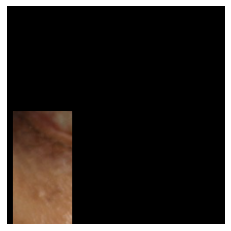

epoch 37
target: 17.0, output: 0.5474615693092346
time: 12.1 sec



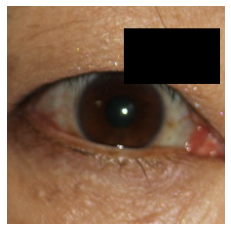

epoch 38
target: 17.0, output: 16.468637466430664
time: 12.3 sec


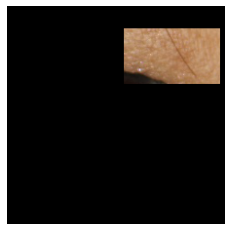

epoch 38
target: 17.0, output: 3.4416470527648926
time: 12.5 sec



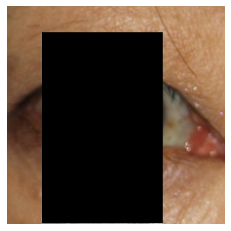

epoch 39
target: 17.0, output: 11.005045890808105
time: 12.6 sec


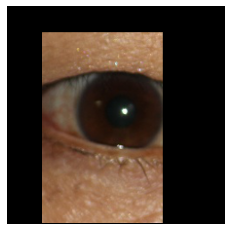

epoch 39
target: 17.0, output: 13.689322471618652
time: 12.8 sec

attention renewed!! (10)



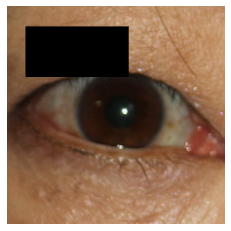

epoch 40
target: 17.0, output: 17.097518920898438
time: 13.0 sec


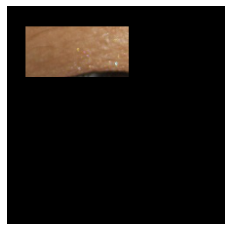

epoch 40
target: 17.0, output: 4.146154403686523
time: 13.1 sec



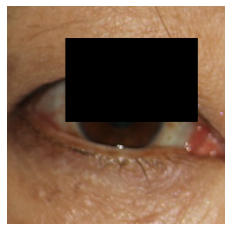

epoch 41
target: 17.0, output: 18.20024299621582
time: 13.3 sec


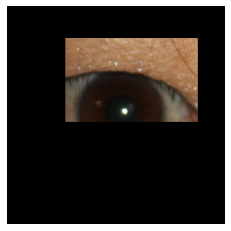

epoch 41
target: 17.0, output: 12.160463333129883
time: 13.5 sec



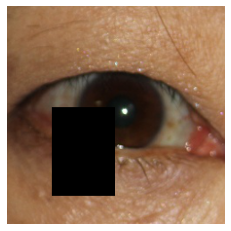

epoch 42
target: 17.0, output: 17.396371841430664
time: 13.7 sec


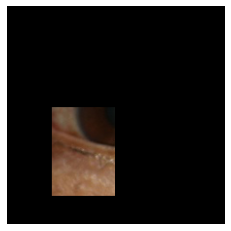

epoch 42
target: 17.0, output: 6.563072204589844
time: 14.1 sec



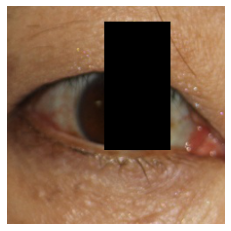

epoch 43
target: 17.0, output: 18.258377075195312
time: 14.3 sec


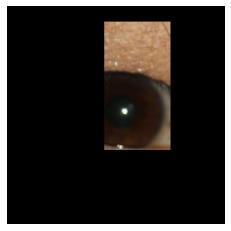

epoch 43
target: 17.0, output: 13.975278854370117
time: 14.5 sec



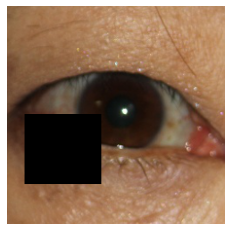

epoch 44
target: 17.0, output: 16.901891708374023
time: 14.7 sec


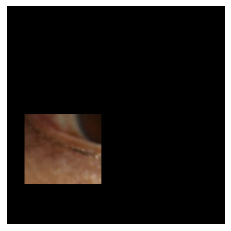

epoch 44
target: 17.0, output: 4.280867099761963
time: 14.9 sec



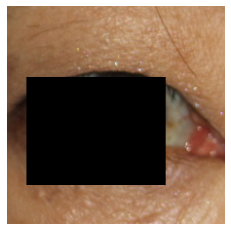

epoch 45
target: 17.0, output: 17.70145034790039
time: 15.1 sec


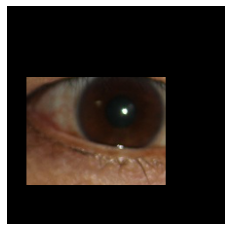

epoch 45
target: 17.0, output: 14.404684066772461
time: 15.3 sec



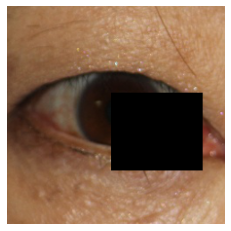

epoch 46
target: 17.0, output: 19.876131057739258
time: 15.6 sec


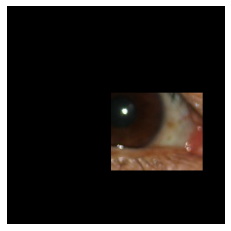

epoch 46
target: 17.0, output: 14.5584077835083
time: 15.7 sec

attention renewed!! (11)



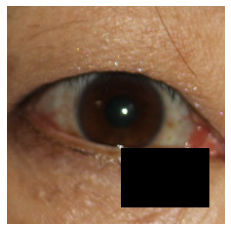

epoch 47
target: 17.0, output: 17.072824478149414
time: 16.0 sec


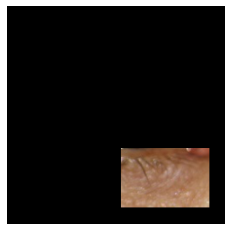

epoch 47
target: 17.0, output: 4.901340484619141
time: 16.1 sec



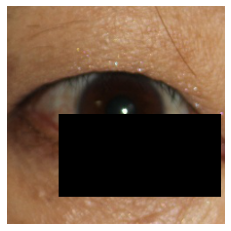

epoch 48
target: 17.0, output: 13.047669410705566
time: 16.4 sec


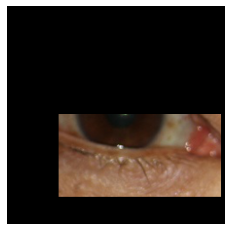

epoch 48
target: 17.0, output: 14.056957244873047
time: 16.6 sec

attention renewed!! (12)



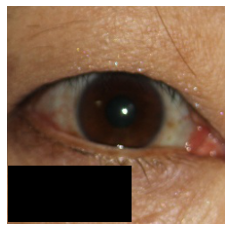

epoch 49
target: 17.0, output: 17.03778648376465
time: 16.8 sec


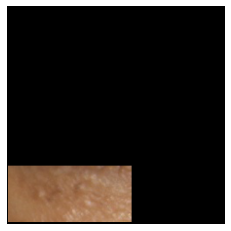

epoch 49
target: 17.0, output: 5.161743640899658
time: 17.0 sec



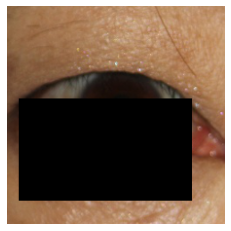

epoch 50
target: 17.0, output: 15.728307723999023
time: 17.3 sec


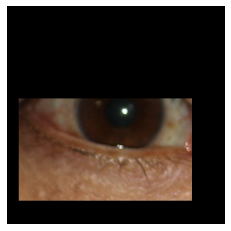

epoch 50
target: 17.0, output: 15.541340827941895
time: 17.5 sec



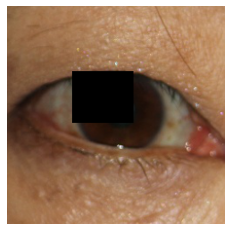

epoch 51
target: 17.0, output: 18.409433364868164
time: 17.7 sec


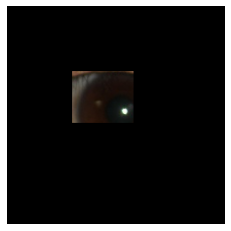

epoch 51
target: 17.0, output: 10.457987785339355
time: 17.9 sec



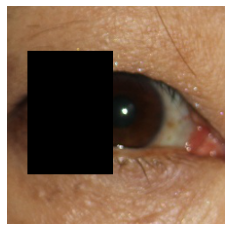

epoch 52
target: 17.0, output: 16.742717742919922
time: 18.1 sec


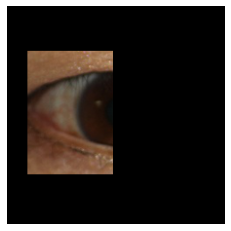

epoch 52
target: 17.0, output: 9.677762985229492
time: 18.3 sec



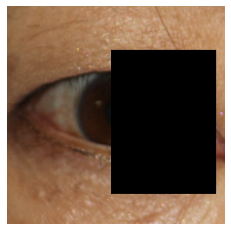

epoch 53
target: 17.0, output: 18.360483169555664
time: 18.6 sec


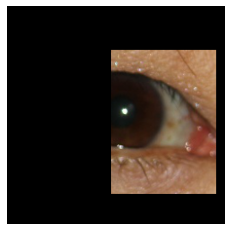

epoch 53
target: 17.0, output: 13.593687057495117
time: 18.7 sec



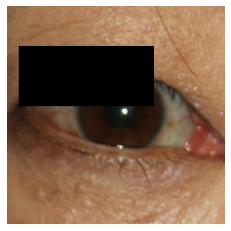

epoch 54
target: 17.0, output: 16.904449462890625
time: 18.9 sec


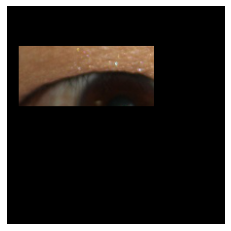

epoch 54
target: 17.0, output: 8.052624702453613
time: 19.1 sec



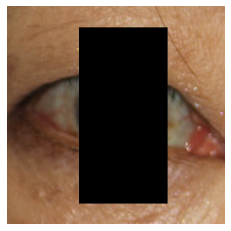

epoch 55
target: 17.0, output: 13.933744430541992
time: 19.4 sec


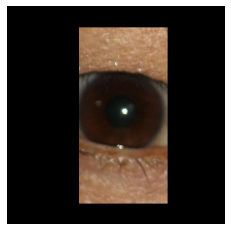

epoch 55
target: 17.0, output: 14.712959289550781
time: 19.6 sec

attention renewed!! (13)



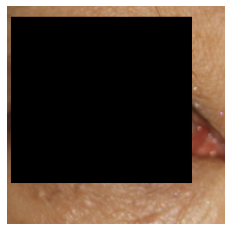

epoch 56
target: 17.0, output: 8.3872709274292
time: 19.8 sec


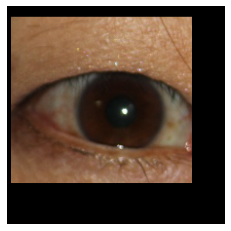

epoch 56
target: 17.0, output: 16.227191925048828
time: 20.0 sec

attention renewed!! (14)



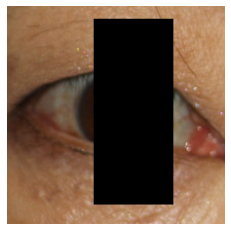

epoch 57
target: 17.0, output: 15.297327041625977
time: 20.3 sec


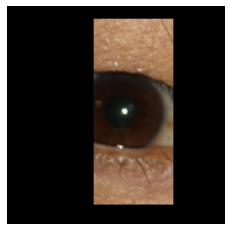

epoch 57
target: 17.0, output: 15.74004077911377
time: 20.4 sec

attention renewed!! (15)



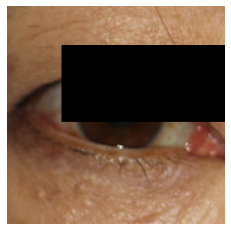

epoch 58
target: 17.0, output: 18.907421112060547
time: 20.8 sec


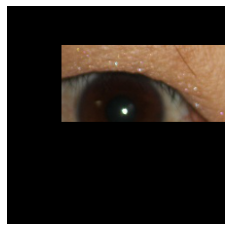

epoch 58
target: 17.0, output: 12.35163402557373
time: 21.0 sec



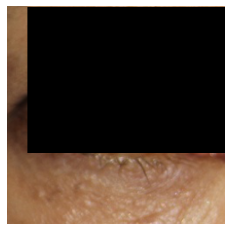

epoch 59
target: 17.0, output: 11.091114044189453
time: 21.2 sec


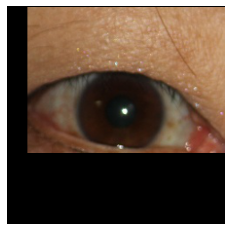

epoch 59
target: 17.0, output: 16.50533103942871
time: 21.4 sec

attention renewed!! (16)



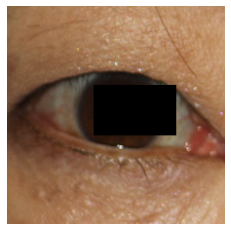

epoch 60
target: 17.0, output: 18.367107391357422
time: 21.7 sec


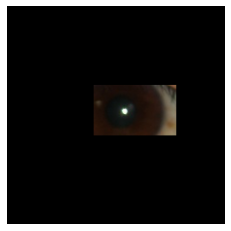

epoch 60
target: 17.0, output: 13.681350708007812
time: 22.0 sec



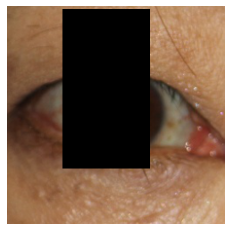

epoch 61
target: 17.0, output: 15.811368942260742
time: 22.3 sec


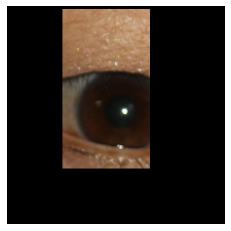

epoch 61
target: 17.0, output: 13.938486099243164
time: 22.5 sec



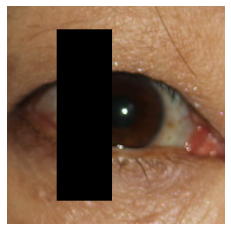

epoch 62
target: 17.0, output: 16.67685890197754
time: 22.7 sec


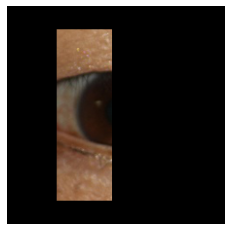

epoch 62
target: 17.0, output: 10.348506927490234
time: 22.9 sec



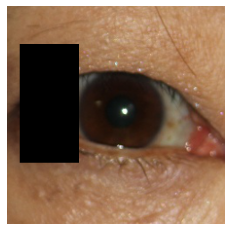

epoch 63
target: 17.0, output: 16.737215042114258
time: 23.1 sec


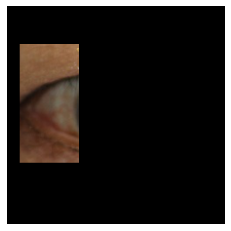

epoch 63
target: 17.0, output: 4.094216823577881
time: 23.3 sec



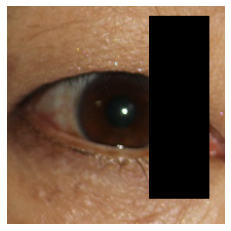

epoch 64
target: 17.0, output: 14.449007034301758
time: 23.6 sec


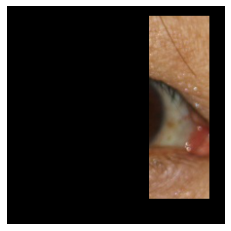

epoch 64
target: 17.0, output: 9.510955810546875
time: 23.8 sec



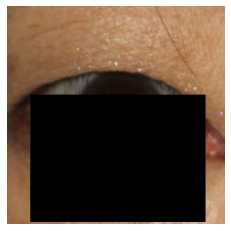

epoch 65
target: 17.0, output: 9.28026008605957
time: 24.1 sec


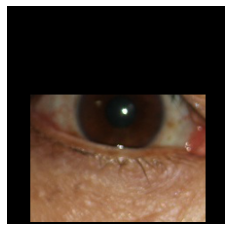

epoch 65
target: 17.0, output: 15.483122825622559
time: 24.3 sec

attention renewed!! (17)



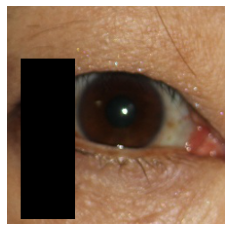

epoch 66
target: 17.0, output: 16.567296981811523
time: 24.6 sec


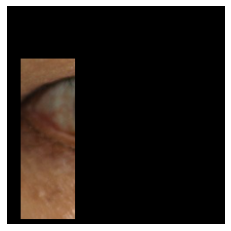

epoch 66
target: 17.0, output: 1.3260592222213745
time: 24.7 sec



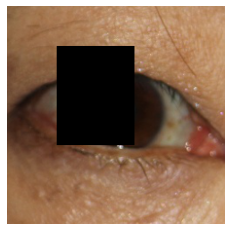

epoch 67
target: 17.0, output: 18.156442642211914
time: 24.9 sec


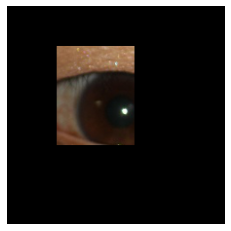

epoch 67
target: 17.0, output: 12.683160781860352
time: 25.0 sec



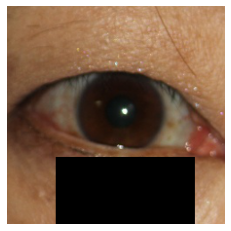

epoch 68
target: 17.0, output: 16.541316986083984
time: 25.2 sec


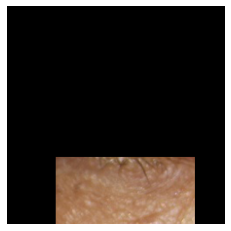

epoch 68
target: 17.0, output: 7.377167701721191
time: 25.3 sec



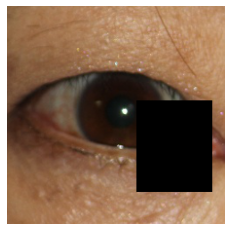

epoch 69
target: 17.0, output: 17.77121353149414
time: 25.5 sec


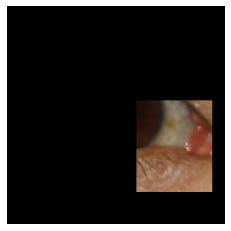

epoch 69
target: 17.0, output: 10.03341007232666
time: 25.6 sec



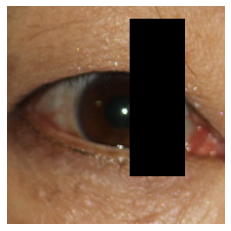

epoch 70
target: 17.0, output: 17.5380802154541
time: 25.8 sec


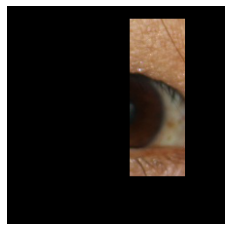

epoch 70
target: 17.0, output: 12.066863059997559
time: 26.0 sec



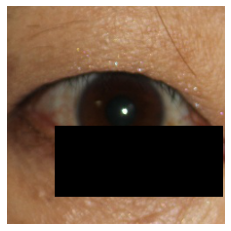

epoch 71
target: 17.0, output: 14.45613956451416
time: 26.1 sec


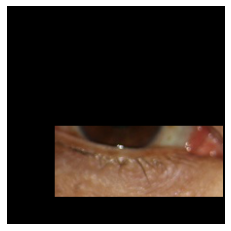

epoch 71
target: 17.0, output: 13.349584579467773
time: 26.3 sec



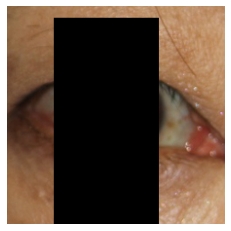

epoch 72
target: 17.0, output: 8.321918487548828
time: 26.4 sec


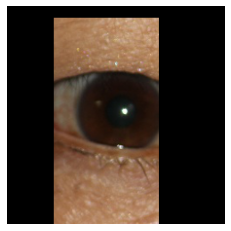

epoch 72
target: 17.0, output: 14.448320388793945
time: 26.6 sec

attention renewed!! (18)



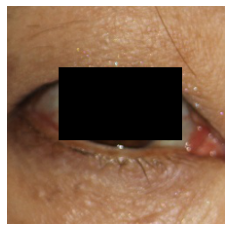

epoch 73
target: 17.0, output: 18.458768844604492
time: 26.8 sec


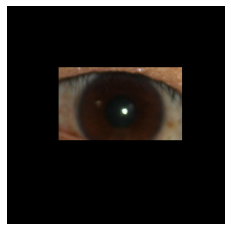

epoch 73
target: 17.0, output: 15.011877059936523
time: 26.9 sec

attention renewed!! (19)



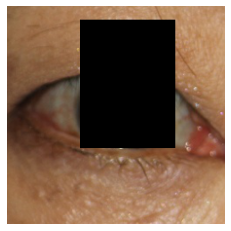

epoch 74
target: 17.0, output: 16.65424919128418
time: 27.1 sec


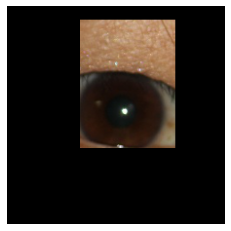

epoch 74
target: 17.0, output: 14.960702896118164
time: 27.2 sec



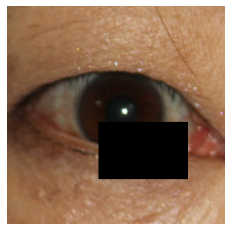

epoch 75
target: 17.0, output: 18.651145935058594
time: 27.4 sec


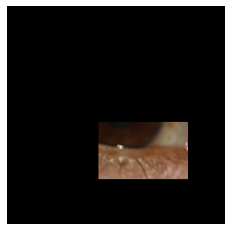

epoch 75
target: 17.0, output: 13.719087600708008
time: 27.6 sec



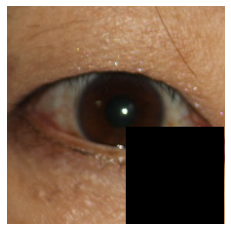

epoch 76
target: 17.0, output: 15.698283195495605
time: 27.7 sec


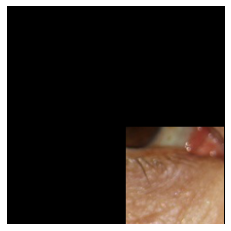

epoch 76
target: 17.0, output: 7.620835781097412
time: 27.9 sec



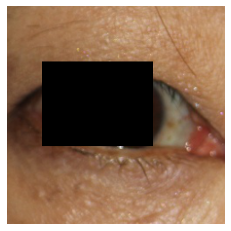

epoch 77
target: 17.0, output: 18.91398048400879
time: 28.0 sec


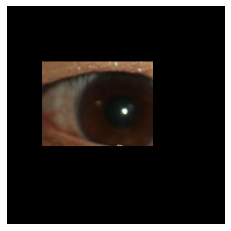

epoch 77
target: 17.0, output: 13.867305755615234
time: 28.2 sec



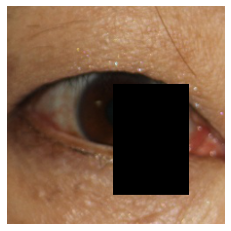

epoch 78
target: 17.0, output: 20.05109214782715
time: 28.4 sec


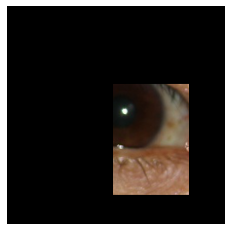

epoch 78
target: 17.0, output: 14.586435317993164
time: 28.6 sec

attention renewed!! (20)



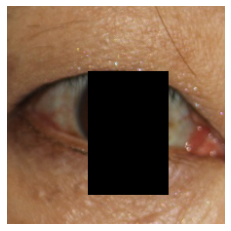

epoch 79
target: 17.0, output: 19.226064682006836
time: 28.8 sec


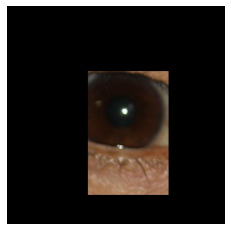

epoch 79
target: 17.0, output: 14.485308647155762
time: 28.9 sec

attention renewed!! (21)



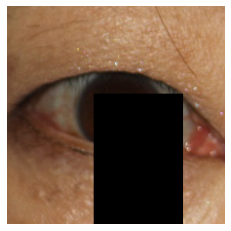

epoch 80
target: 17.0, output: 15.679916381835938
time: 29.1 sec


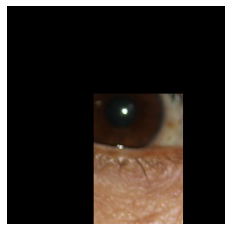

epoch 80
target: 17.0, output: 14.794158935546875
time: 29.2 sec



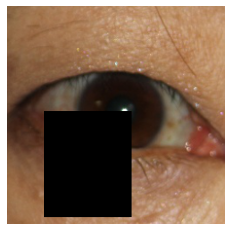

epoch 81
target: 17.0, output: 15.886558532714844
time: 29.4 sec


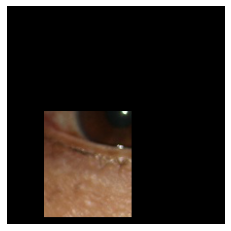

epoch 81
target: 17.0, output: 11.120039939880371
time: 29.6 sec



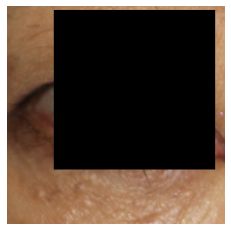

epoch 82
target: 17.0, output: 8.019909858703613
time: 29.7 sec


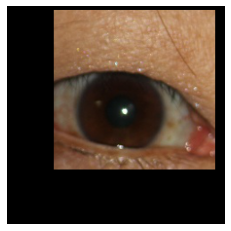

epoch 82
target: 17.0, output: 16.678085327148438
time: 29.9 sec

attention renewed!! (22)



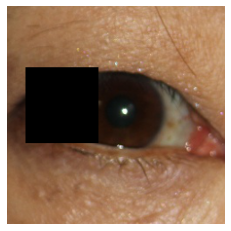

epoch 83
target: 17.0, output: 17.335031509399414
time: 30.0 sec


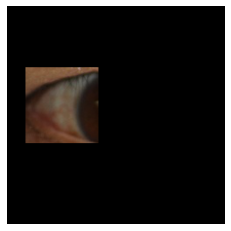

epoch 83
target: 17.0, output: 9.886553764343262
time: 30.2 sec



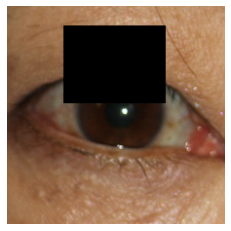

epoch 84
target: 17.0, output: 16.331331253051758
time: 30.4 sec


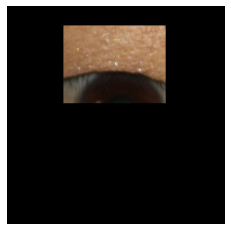

epoch 84
target: 17.0, output: 7.161906719207764
time: 30.5 sec



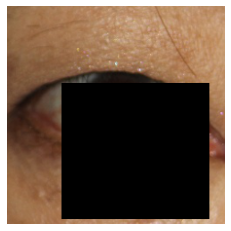

epoch 85
target: 17.0, output: 10.555553436279297
time: 30.7 sec


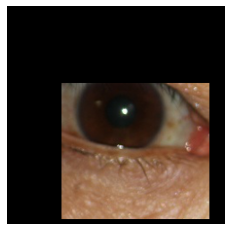

epoch 85
target: 17.0, output: 15.308156967163086
time: 30.8 sec

attention renewed!! (23)



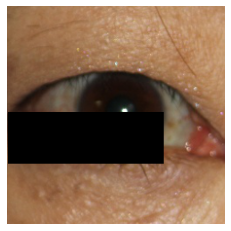

epoch 86
target: 17.0, output: 17.875255584716797
time: 31.0 sec


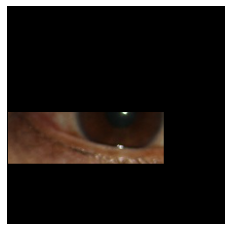

epoch 86
target: 17.0, output: 14.175251007080078
time: 31.1 sec



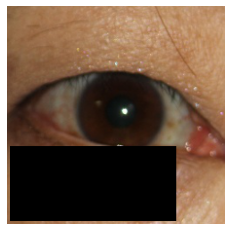

epoch 87
target: 17.0, output: 16.41607093811035
time: 31.3 sec


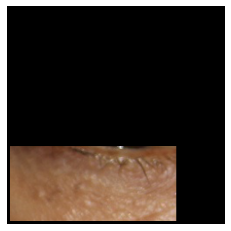

epoch 87
target: 17.0, output: 9.20854377746582
time: 31.4 sec



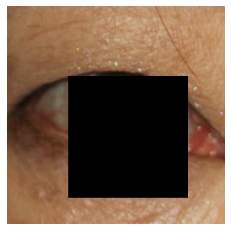

epoch 88
target: 17.0, output: 16.113601684570312
time: 31.6 sec


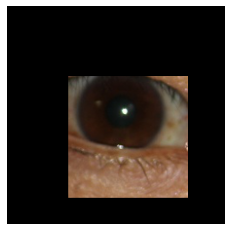

epoch 88
target: 17.0, output: 15.546218872070312
time: 31.7 sec



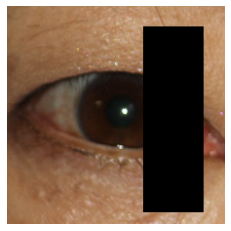

epoch 89
target: 17.0, output: 14.751091957092285
time: 31.9 sec


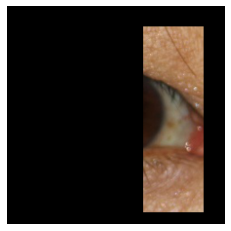

epoch 89
target: 17.0, output: 10.16461181640625
time: 32.0 sec



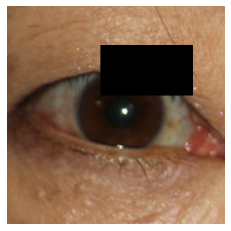

epoch 90
target: 17.0, output: 17.325206756591797
time: 32.2 sec


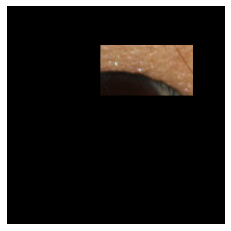

epoch 90
target: 17.0, output: 4.5188164710998535
time: 32.4 sec



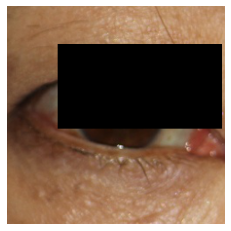

epoch 91
target: 17.0, output: 18.879932403564453
time: 32.5 sec


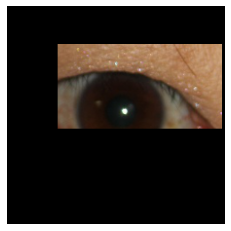

epoch 91
target: 17.0, output: 13.317678451538086
time: 32.7 sec



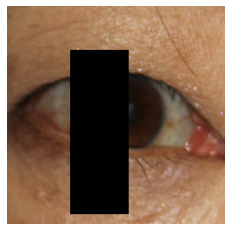

epoch 92
target: 17.0, output: 16.528093338012695
time: 32.8 sec


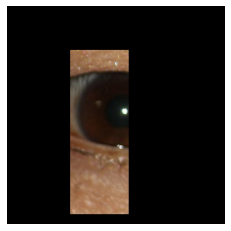

epoch 92
target: 17.0, output: 11.05423355102539
time: 33.0 sec



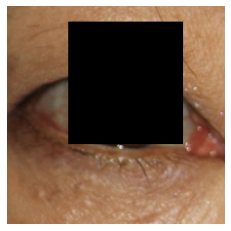

epoch 93
target: 17.0, output: 15.981557846069336
time: 33.2 sec


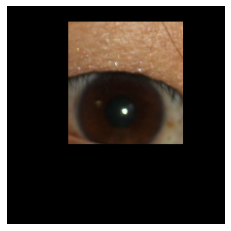

epoch 93
target: 17.0, output: 14.662313461303711
time: 33.3 sec



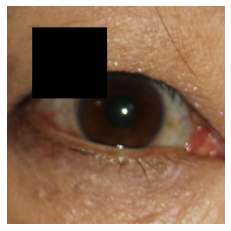

epoch 94
target: 17.0, output: 16.77040672302246
time: 33.5 sec


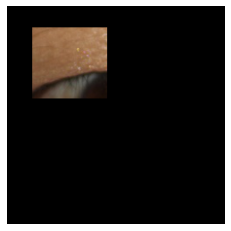

epoch 94
target: 17.0, output: 2.568772792816162
time: 33.6 sec



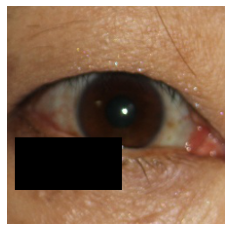

epoch 95
target: 17.0, output: 17.75013542175293
time: 33.8 sec


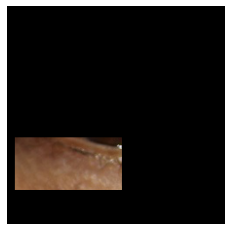

epoch 95
target: 17.0, output: 4.564212799072266
time: 33.9 sec



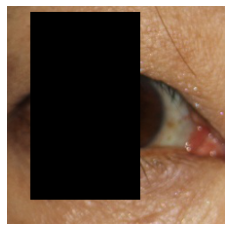

epoch 96
target: 17.0, output: 15.883495330810547
time: 34.1 sec


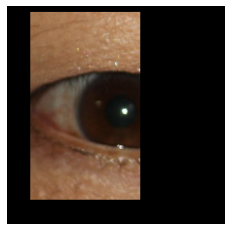

epoch 96
target: 17.0, output: 13.400827407836914
time: 34.4 sec



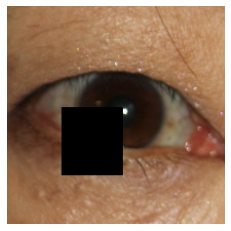

epoch 97
target: 17.0, output: 17.401878356933594
time: 34.6 sec


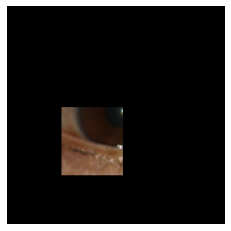

epoch 97
target: 17.0, output: 11.117393493652344
time: 34.7 sec



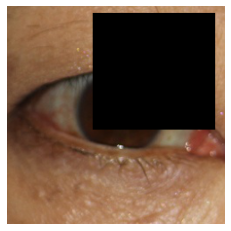

epoch 98
target: 17.0, output: 14.756921768188477
time: 34.9 sec


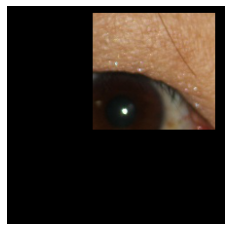

epoch 98
target: 17.0, output: 14.030345916748047
time: 35.1 sec



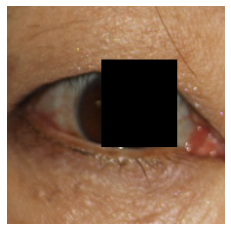

epoch 99
target: 17.0, output: 19.653413772583008
time: 35.2 sec


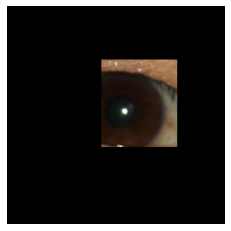

epoch 99
target: 17.0, output: 13.626935958862305
time: 35.4 sec



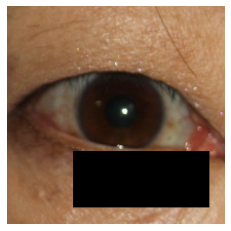

epoch 100
target: 17.0, output: 16.569843292236328
time: 35.5 sec


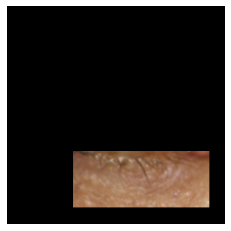

epoch 100
target: 17.0, output: 8.353144645690918
time: 35.7 sec



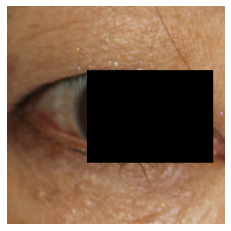

epoch 101
target: 17.0, output: 19.671688079833984
time: 35.9 sec


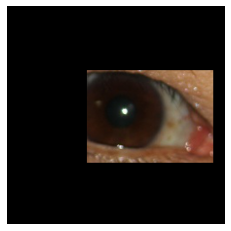

epoch 101
target: 17.0, output: 15.472412109375
time: 36.0 sec

attention renewed!! (24)



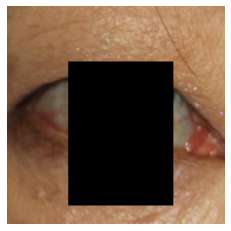

epoch 102
target: 17.0, output: 16.425840377807617
time: 36.2 sec


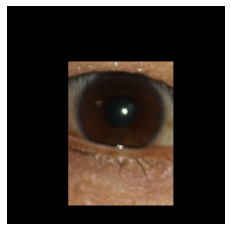

epoch 102
target: 17.0, output: 14.946263313293457
time: 36.3 sec



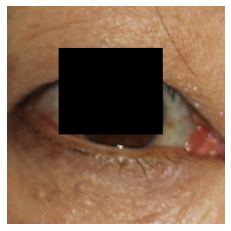

epoch 103
target: 17.0, output: 18.6461124420166
time: 36.5 sec


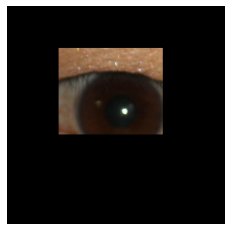

epoch 103
target: 17.0, output: 12.879650115966797
time: 36.6 sec



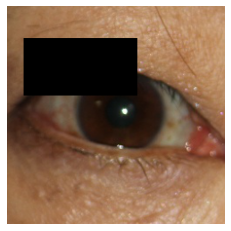

epoch 104
target: 17.0, output: 17.420259475708008
time: 36.8 sec


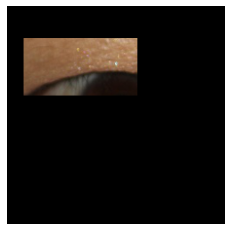

epoch 104
target: 17.0, output: 4.622837066650391
time: 36.9 sec



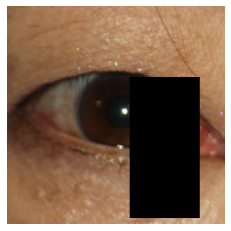

epoch 105
target: 17.0, output: 16.304481506347656
time: 37.1 sec


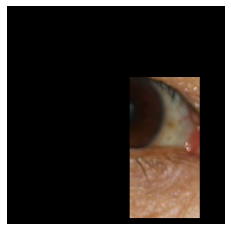

epoch 105
target: 17.0, output: 11.204291343688965
time: 37.2 sec



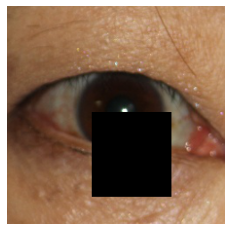

epoch 106
target: 17.0, output: 19.197336196899414
time: 37.4 sec


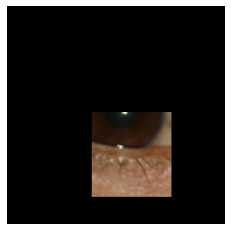

epoch 106
target: 17.0, output: 13.6196870803833
time: 37.5 sec



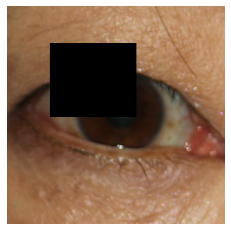

epoch 107
target: 17.0, output: 17.562889099121094
time: 37.7 sec


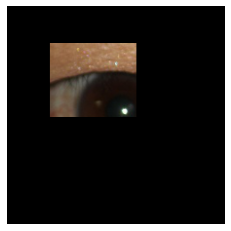

epoch 107
target: 17.0, output: 9.475034713745117
time: 37.8 sec



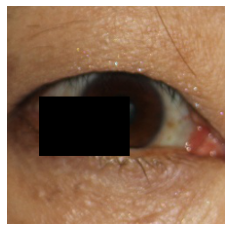

epoch 108
target: 17.0, output: 17.939016342163086
time: 38.0 sec


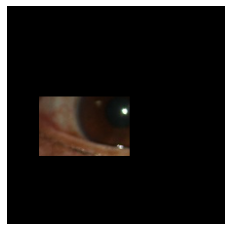

epoch 108
target: 17.0, output: 12.508527755737305
time: 38.1 sec



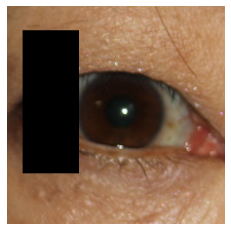

epoch 109
target: 17.0, output: 16.396320343017578
time: 38.3 sec


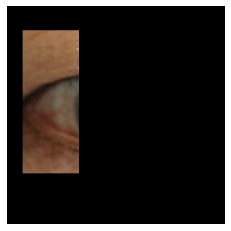

epoch 109
target: 17.0, output: 3.3783388137817383
time: 38.5 sec



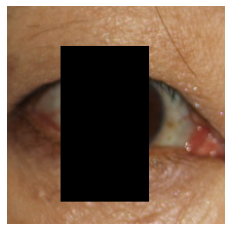

epoch 110
target: 17.0, output: 17.974443435668945
time: 38.6 sec


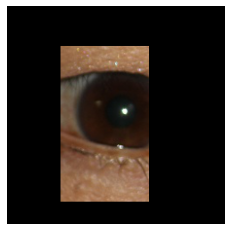

epoch 110
target: 17.0, output: 12.407471656799316
time: 38.8 sec



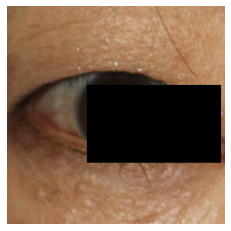

epoch 111
target: 17.0, output: 20.02393341064453
time: 39.0 sec


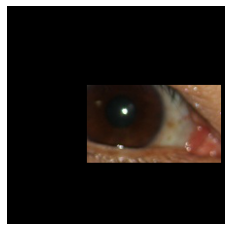

epoch 111
target: 17.0, output: 15.431632995605469
time: 39.1 sec

attention renewed!! (25)



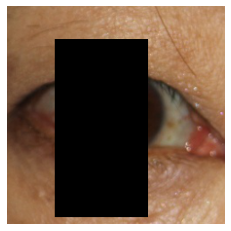

epoch 112
target: 17.0, output: 12.932443618774414
time: 39.3 sec


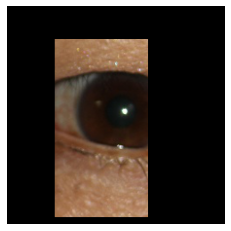

epoch 112
target: 17.0, output: 12.5567626953125
time: 39.4 sec



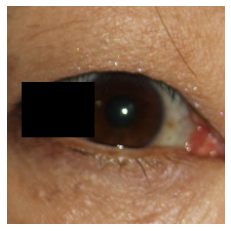

epoch 113
target: 17.0, output: 17.216073989868164
time: 39.6 sec


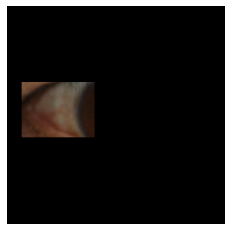

epoch 113
target: 17.0, output: 8.279908180236816
time: 39.7 sec



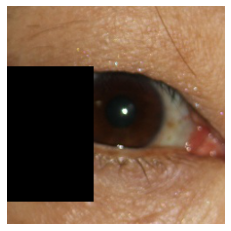

epoch 114
target: 17.0, output: 16.798742294311523
time: 39.9 sec


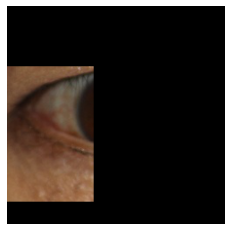

epoch 114
target: 17.0, output: 6.225311756134033
time: 40.2 sec



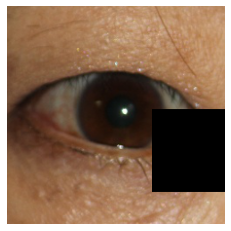

epoch 115
target: 17.0, output: 17.601036071777344
time: 40.3 sec


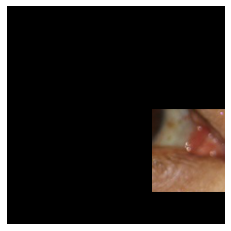

epoch 115
target: 17.0, output: 6.960052013397217
time: 40.5 sec



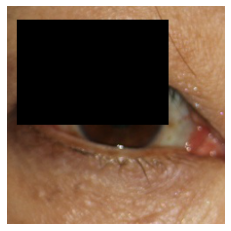

epoch 116
target: 17.0, output: 14.019083023071289
time: 40.6 sec


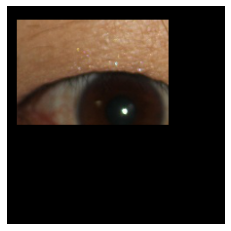

epoch 116
target: 17.0, output: 13.118038177490234
time: 40.8 sec



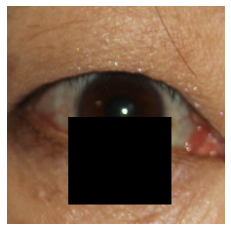

epoch 117
target: 17.0, output: 17.11167335510254
time: 41.0 sec


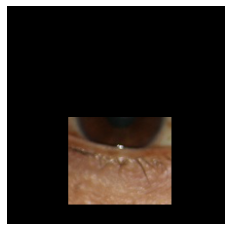

epoch 117
target: 17.0, output: 13.870628356933594
time: 41.1 sec



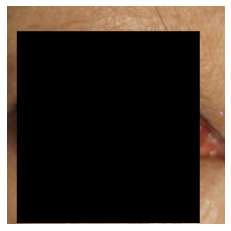

epoch 118
target: 17.0, output: 7.793283462524414
time: 41.3 sec


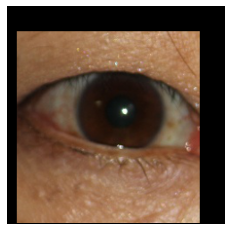

epoch 118
target: 17.0, output: 15.810813903808594
time: 41.4 sec

attention renewed!! (26)



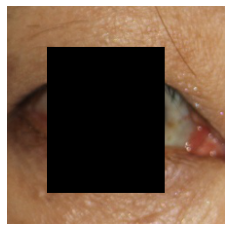

epoch 119
target: 17.0, output: 17.299448013305664
time: 41.6 sec


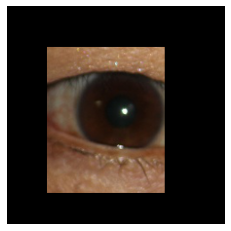

epoch 119
target: 17.0, output: 14.243947982788086
time: 41.7 sec



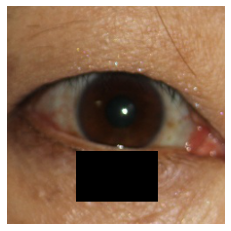

epoch 120
target: 17.0, output: 17.4954776763916
time: 41.9 sec


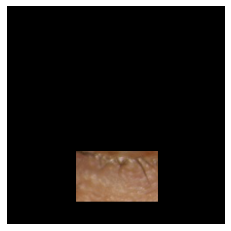

epoch 120
target: 17.0, output: 5.789223670959473
time: 42.0 sec



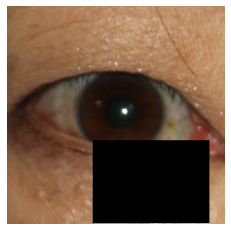

epoch 121
target: 17.0, output: 16.053464889526367
time: 42.2 sec


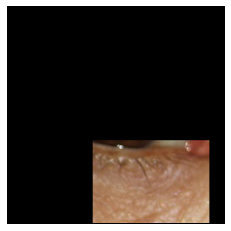

epoch 121
target: 17.0, output: 7.679004192352295
time: 42.3 sec



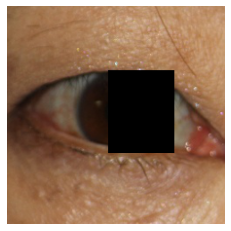

epoch 122
target: 17.0, output: 20.02776527404785
time: 42.5 sec


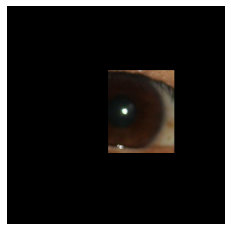

epoch 122
target: 17.0, output: 13.661462783813477
time: 42.7 sec

attention renewed!! (27)



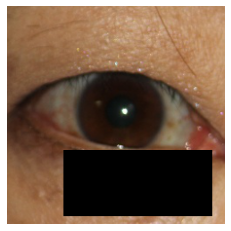

epoch 123
target: 17.0, output: 16.27879524230957
time: 42.8 sec


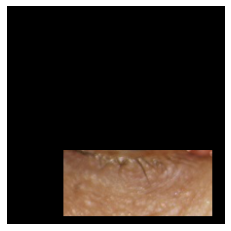

epoch 123
target: 17.0, output: 9.372225761413574
time: 43.0 sec



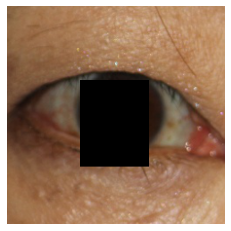

epoch 124
target: 17.0, output: 20.587400436401367
time: 43.1 sec


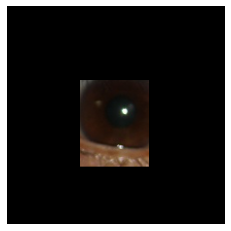

epoch 124
target: 17.0, output: 13.926419258117676
time: 43.3 sec

attention renewed!! (28)



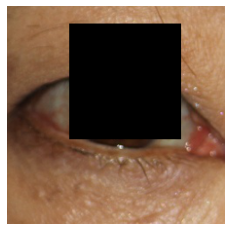

epoch 125
target: 17.0, output: 16.317100524902344
time: 43.5 sec


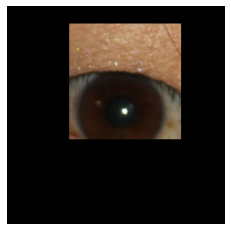

epoch 125
target: 17.0, output: 14.798975944519043
time: 43.6 sec



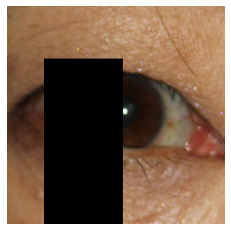

epoch 126
target: 17.0, output: 16.535364151000977
time: 43.8 sec


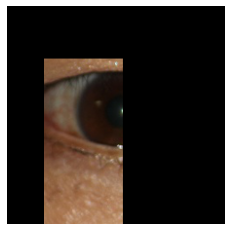

epoch 126
target: 17.0, output: 13.111809730529785
time: 43.9 sec



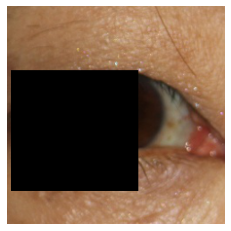

epoch 127
target: 17.0, output: 19.867128372192383
time: 44.1 sec


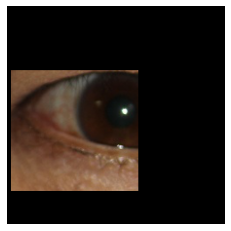

epoch 127
target: 17.0, output: 13.616607666015625
time: 44.2 sec

attention renewed!! (29)



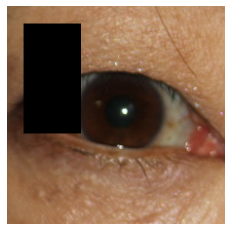

epoch 128
target: 17.0, output: 16.570775985717773
time: 44.4 sec


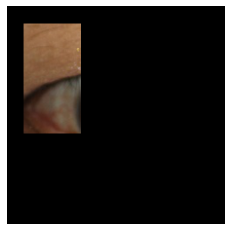

epoch 128
target: 17.0, output: 4.999458312988281
time: 44.5 sec



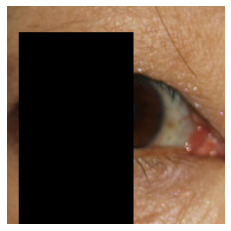

epoch 129
target: 17.0, output: 14.265612602233887
time: 44.7 sec


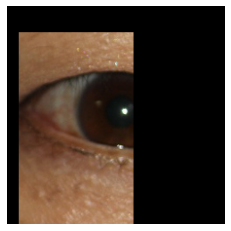

epoch 129
target: 17.0, output: 12.991857528686523
time: 44.8 sec



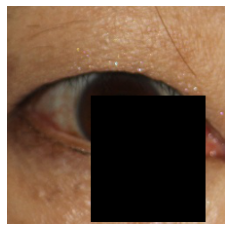

epoch 130
target: 17.0, output: 13.605962753295898
time: 45.0 sec


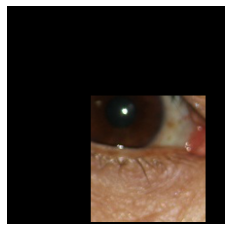

epoch 130
target: 17.0, output: 14.950539588928223
time: 45.1 sec

attention renewed!! (30)



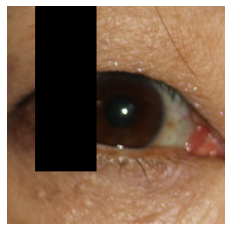

epoch 131
target: 17.0, output: 16.42435646057129
time: 45.3 sec


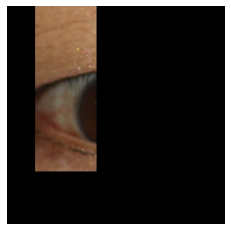

epoch 131
target: 17.0, output: 7.097760200500488
time: 45.4 sec



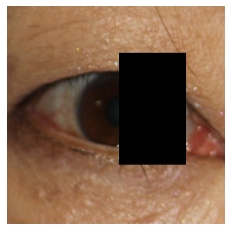

epoch 132
target: 17.0, output: 21.993024826049805
time: 45.6 sec


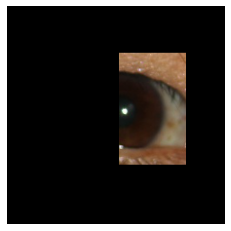

epoch 132
target: 17.0, output: 14.093592643737793
time: 45.9 sec

attention renewed!! (31)



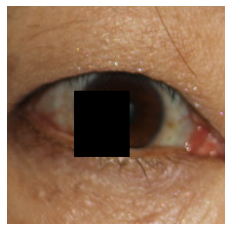

epoch 133
target: 17.0, output: 18.32015609741211
time: 46.1 sec


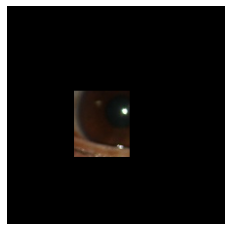

epoch 133
target: 17.0, output: 13.349797248840332
time: 46.2 sec



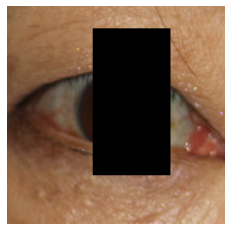

epoch 134
target: 17.0, output: 18.378637313842773
time: 46.4 sec


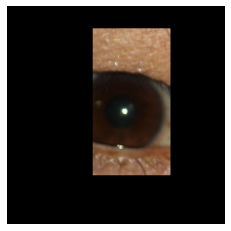

epoch 134
target: 17.0, output: 14.630343437194824
time: 46.5 sec



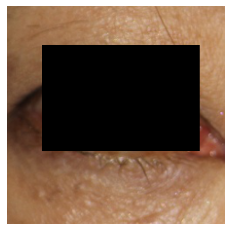

epoch 135
target: 17.0, output: 21.124475479125977
time: 46.7 sec


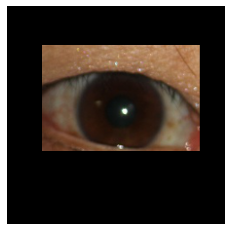

epoch 135
target: 17.0, output: 15.324766159057617
time: 46.8 sec

attention renewed!! (32)



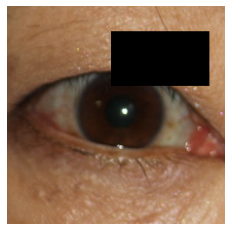

epoch 136
target: 17.0, output: 16.946664810180664
time: 47.0 sec


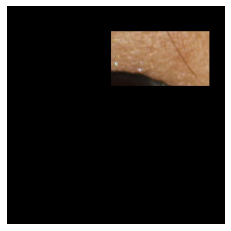

epoch 136
target: 17.0, output: 4.737903594970703
time: 47.2 sec



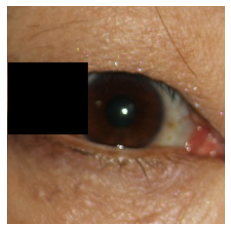

epoch 137
target: 17.0, output: 17.344860076904297
time: 47.3 sec


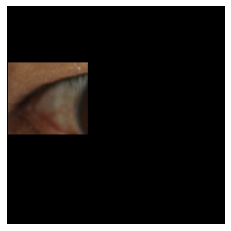

epoch 137
target: 17.0, output: 5.876725673675537
time: 47.5 sec



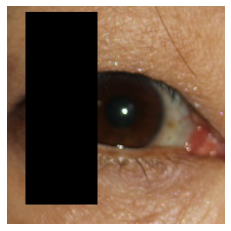

epoch 138
target: 17.0, output: 15.594319343566895
time: 47.7 sec


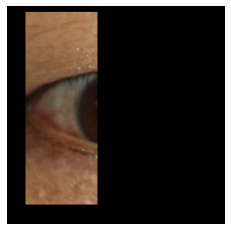

epoch 138
target: 17.0, output: 7.332931041717529
time: 47.8 sec



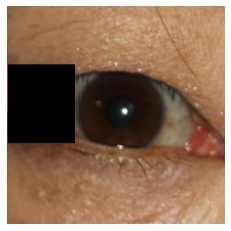

epoch 139
target: 17.0, output: 16.92406463623047
time: 48.0 sec


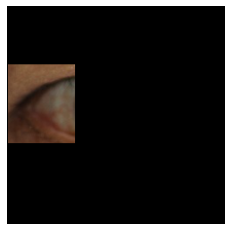

epoch 139
target: 17.0, output: 5.375851154327393
time: 48.1 sec



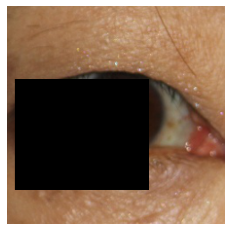

epoch 140
target: 17.0, output: 18.732763290405273
time: 48.3 sec


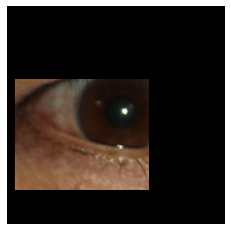

epoch 140
target: 17.0, output: 13.565632820129395
time: 48.4 sec



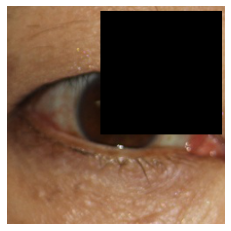

epoch 141
target: 17.0, output: 15.144537925720215
time: 48.6 sec


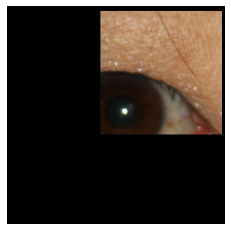

epoch 141
target: 17.0, output: 14.189420700073242
time: 48.7 sec



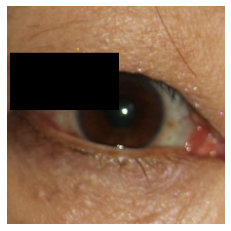

epoch 142
target: 17.0, output: 17.437023162841797
time: 48.9 sec


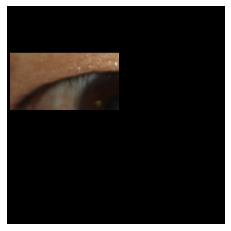

epoch 142
target: 17.0, output: 5.440696716308594
time: 49.0 sec



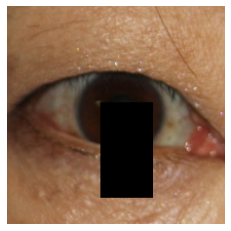

epoch 143
target: 17.0, output: 22.24953269958496
time: 49.2 sec


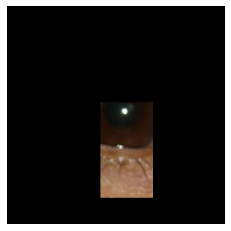

epoch 143
target: 17.0, output: 13.191652297973633
time: 49.3 sec

attention renewed!! (33)



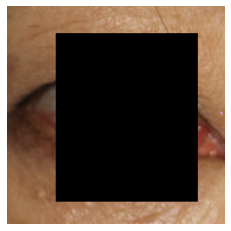

epoch 144
target: 17.0, output: 12.984832763671875
time: 49.5 sec


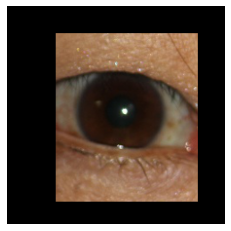

epoch 144
target: 17.0, output: 16.185396194458008
time: 49.7 sec

attention renewed!! (34)



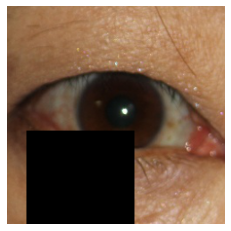

epoch 145
target: 17.0, output: 15.997968673706055
time: 49.8 sec


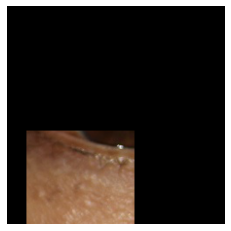

epoch 145
target: 17.0, output: 6.554795742034912
time: 50.0 sec



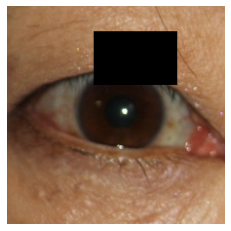

epoch 146
target: 17.0, output: 16.660903930664062
time: 50.2 sec


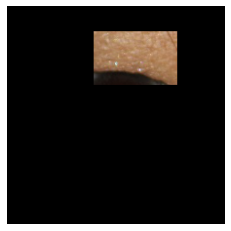

epoch 146
target: 17.0, output: 3.9375038146972656
time: 50.3 sec



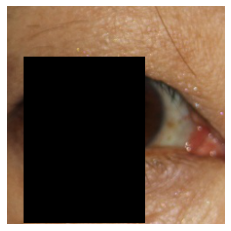

epoch 147
target: 17.0, output: 14.100272178649902
time: 50.5 sec


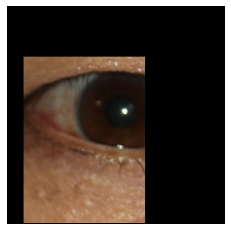

epoch 147
target: 17.0, output: 12.977754592895508
time: 50.6 sec



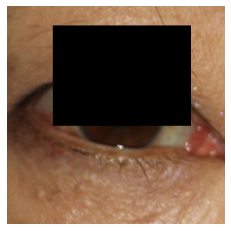

epoch 148
target: 17.0, output: 15.882139205932617
time: 50.8 sec


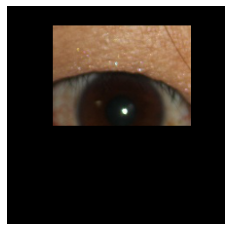

epoch 148
target: 17.0, output: 14.072647094726562
time: 50.9 sec



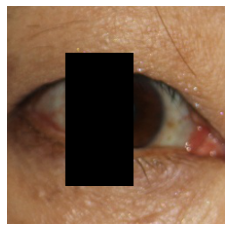

epoch 149
target: 17.0, output: 19.5349178314209
time: 51.1 sec


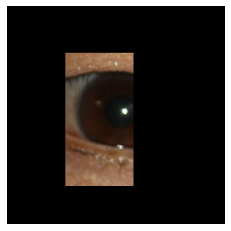

epoch 149
target: 17.0, output: 11.771268844604492
time: 51.2 sec



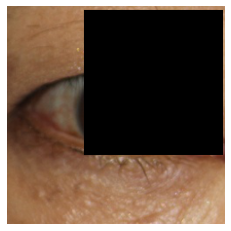

epoch 150
target: 17.0, output: 14.115459442138672
time: 51.4 sec


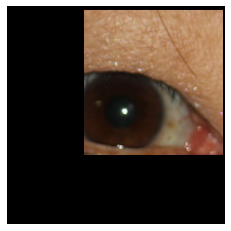

epoch 150
target: 17.0, output: 16.243757247924805
time: 51.7 sec

attention renewed!! (35)



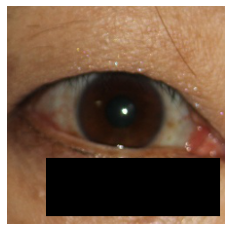

epoch 151
target: 17.0, output: 16.500051498413086
time: 51.9 sec


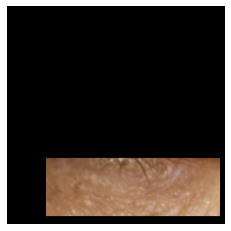

epoch 151
target: 17.0, output: 8.105225563049316
time: 52.0 sec



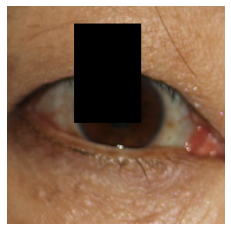

epoch 152
target: 17.0, output: 17.020614624023438
time: 52.2 sec


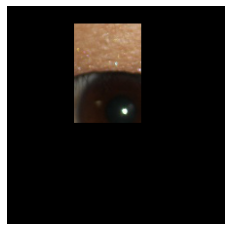

epoch 152
target: 17.0, output: 10.324151039123535
time: 52.3 sec



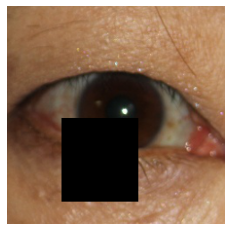

epoch 153
target: 17.0, output: 18.259618759155273
time: 52.5 sec


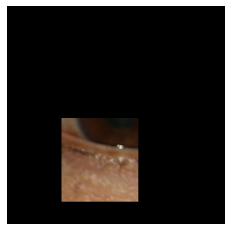

epoch 153
target: 17.0, output: 9.719085693359375
time: 52.7 sec



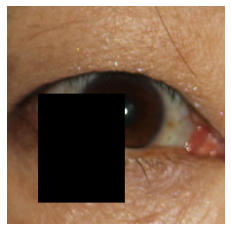

epoch 154
target: 17.0, output: 17.809829711914062
time: 52.8 sec


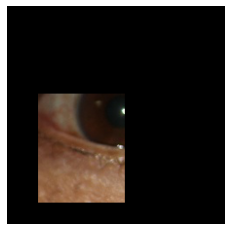

epoch 154
target: 17.0, output: 12.595416069030762
time: 53.0 sec



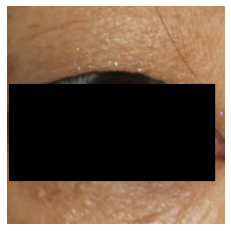

epoch 155
target: 17.0, output: 17.554466247558594
time: 53.2 sec


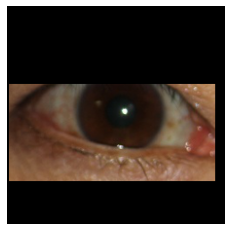

epoch 155
target: 17.0, output: 15.46902084350586
time: 53.3 sec



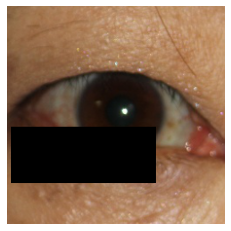

epoch 156
target: 17.0, output: 18.901233673095703
time: 53.5 sec


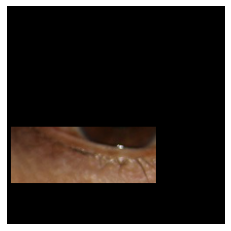

epoch 156
target: 17.0, output: 11.483715057373047
time: 53.7 sec



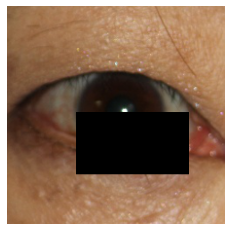

epoch 157
target: 17.0, output: 17.237565994262695
time: 53.9 sec


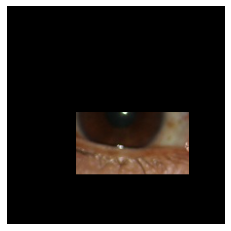

epoch 157
target: 17.0, output: 15.042413711547852
time: 54.1 sec



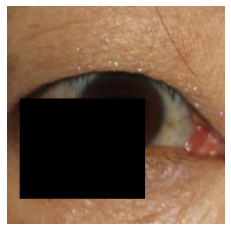

epoch 158
target: 17.0, output: 19.156455993652344
time: 54.3 sec


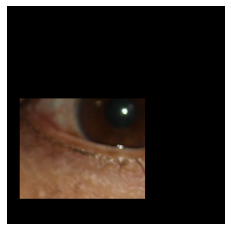

epoch 158
target: 17.0, output: 12.885554313659668
time: 54.5 sec



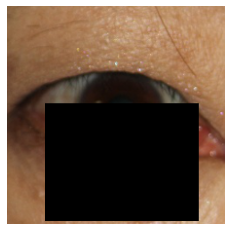

epoch 159
target: 17.0, output: 10.588119506835938
time: 54.7 sec


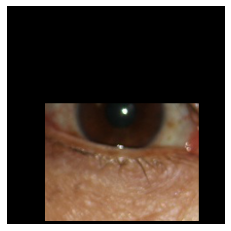

epoch 159
target: 17.0, output: 14.576791763305664
time: 54.9 sec

attention renewed!! (36)



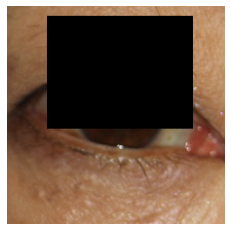

epoch 160
target: 17.0, output: 13.627969741821289
time: 55.2 sec


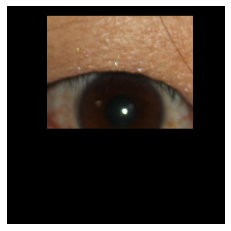

epoch 160
target: 17.0, output: 15.202463150024414
time: 55.4 sec

attention renewed!! (37)



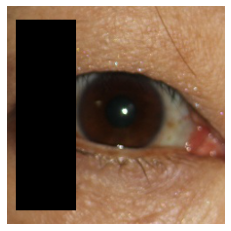

epoch 161
target: 17.0, output: 16.38733673095703
time: 55.6 sec


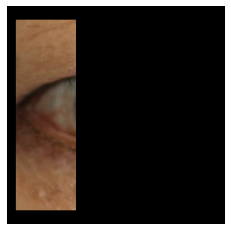

epoch 161
target: 17.0, output: 1.3443946838378906
time: 55.8 sec



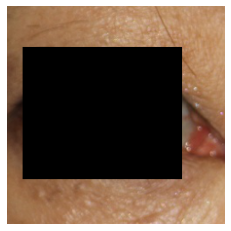

epoch 162
target: 17.0, output: 17.97784996032715
time: 56.0 sec


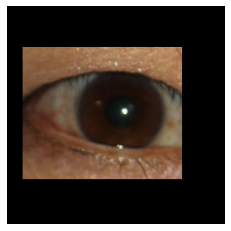

epoch 162
target: 17.0, output: 15.432985305786133
time: 56.2 sec

attention renewed!! (38)



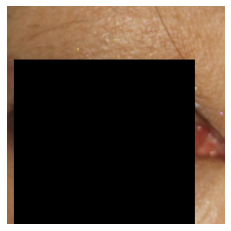

epoch 163
target: 17.0, output: 9.984292030334473
time: 56.4 sec


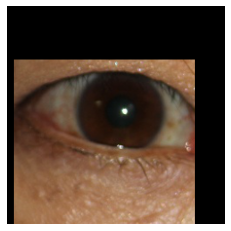

epoch 163
target: 17.0, output: 16.114500045776367
time: 56.6 sec

attention renewed!! (39)



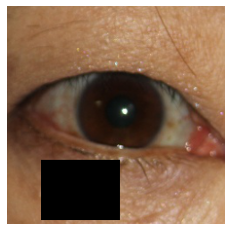

epoch 164
target: 17.0, output: 16.84886360168457
time: 56.9 sec


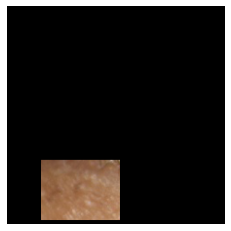

epoch 164
target: 17.0, output: 2.171057939529419
time: 57.0 sec



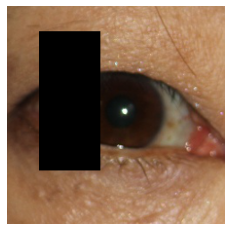

epoch 165
target: 17.0, output: 16.53989601135254
time: 57.2 sec


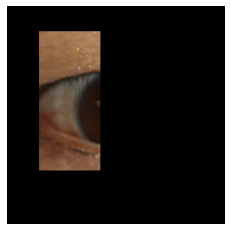

epoch 165
target: 17.0, output: 8.751907348632812
time: 57.4 sec



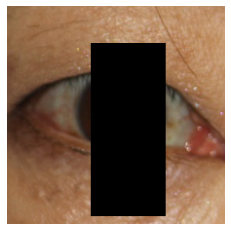

epoch 166
target: 17.0, output: 15.444063186645508
time: 57.5 sec


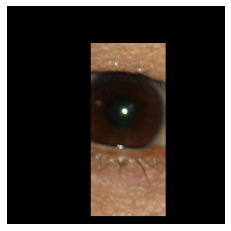

epoch 166
target: 17.0, output: 13.388721466064453
time: 57.7 sec



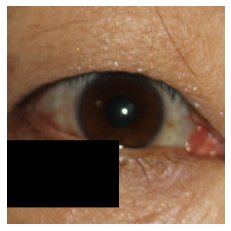

epoch 167
target: 17.0, output: 17.759462356567383
time: 57.9 sec


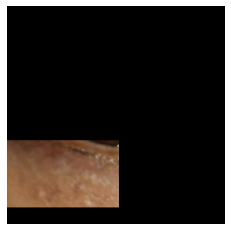

epoch 167
target: 17.0, output: 3.088419198989868
time: 58.0 sec



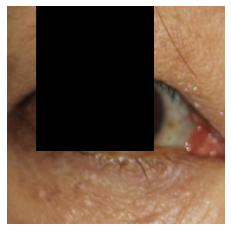

epoch 168
target: 17.0, output: 16.063152313232422
time: 58.2 sec


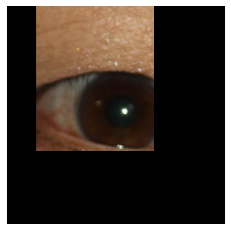

epoch 168
target: 17.0, output: 14.226659774780273
time: 58.5 sec



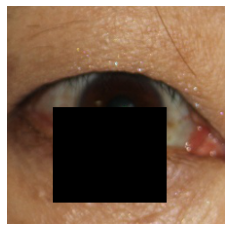

epoch 169
target: 17.0, output: 16.894062042236328
time: 58.6 sec


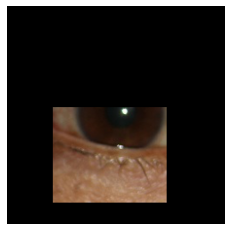

epoch 169
target: 17.0, output: 13.95701789855957
time: 58.8 sec



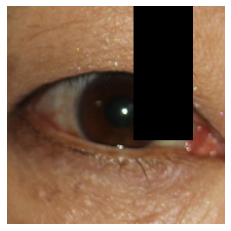

epoch 170
target: 17.0, output: 15.695589065551758
time: 59.0 sec


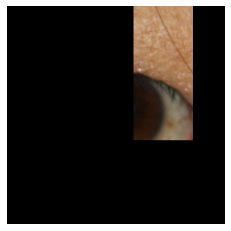

epoch 170
target: 17.0, output: 11.65069580078125
time: 59.1 sec



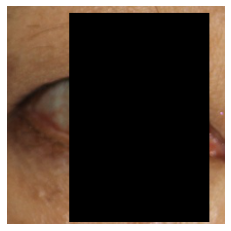

epoch 171
target: 17.0, output: 2.5962846279144287
time: 59.3 sec


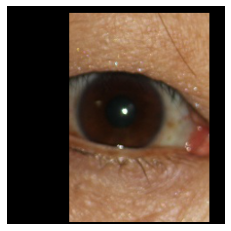

epoch 171
target: 17.0, output: 16.041526794433594
time: 59.4 sec

attention renewed!! (40)



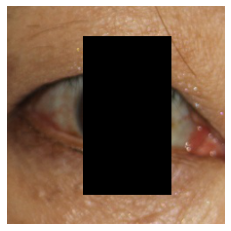

epoch 172
target: 17.0, output: 17.040363311767578
time: 59.6 sec


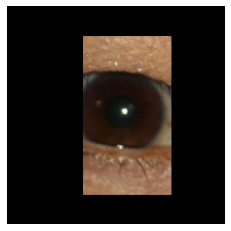

epoch 172
target: 17.0, output: 14.020532608032227
time: 59.7 sec



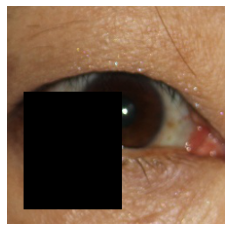

epoch 173
target: 17.0, output: 16.602672576904297
time: 59.9 sec


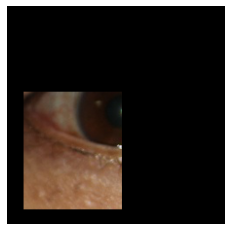

epoch 173
target: 17.0, output: 12.201757431030273
time: 60.0 sec



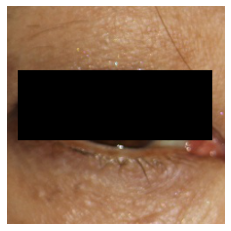

epoch 174
target: 17.0, output: 20.630882263183594
time: 60.2 sec


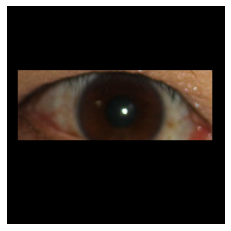

epoch 174
target: 17.0, output: 15.396415710449219
time: 60.4 sec

attention renewed!! (41)



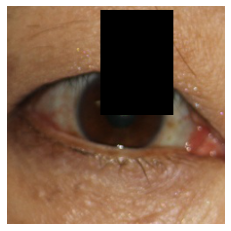

epoch 175
target: 17.0, output: 16.285396575927734
time: 60.5 sec


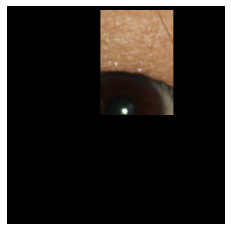

epoch 175
target: 17.0, output: 10.804226875305176
time: 60.7 sec



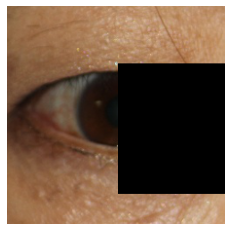

epoch 176
target: 17.0, output: 19.170007705688477
time: 60.9 sec


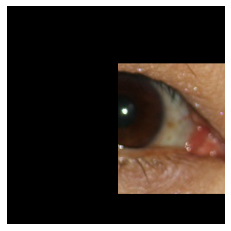

epoch 176
target: 17.0, output: 14.126102447509766
time: 61.0 sec

attention renewed!! (42)



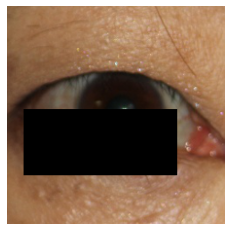

epoch 177
target: 17.0, output: 17.562166213989258
time: 61.2 sec


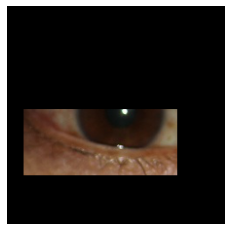

epoch 177
target: 17.0, output: 14.628026008605957
time: 61.3 sec



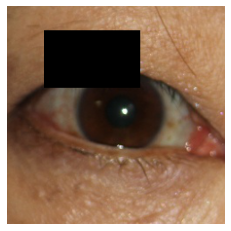

epoch 178
target: 17.0, output: 17.32337188720703
time: 61.5 sec


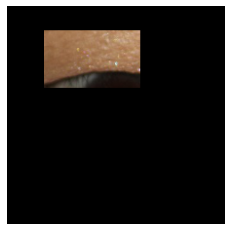

epoch 178
target: 17.0, output: 4.807740211486816
time: 61.6 sec



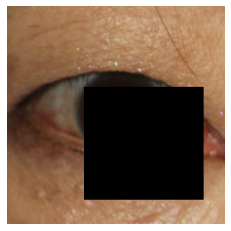

epoch 179
target: 17.0, output: 16.315208435058594
time: 61.8 sec


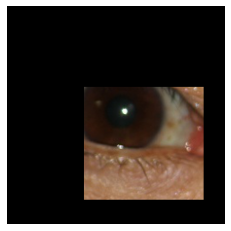

epoch 179
target: 17.0, output: 16.137863159179688
time: 62.0 sec



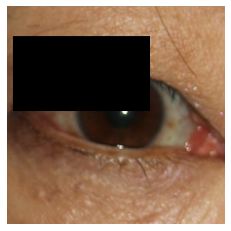

epoch 180
target: 17.0, output: 17.046518325805664
time: 62.1 sec


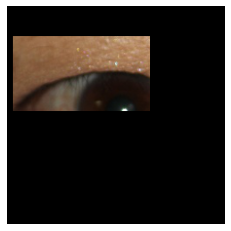

epoch 180
target: 17.0, output: 9.971541404724121
time: 62.3 sec



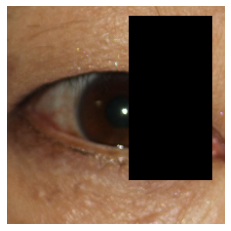

epoch 181
target: 17.0, output: 15.854520797729492
time: 62.4 sec


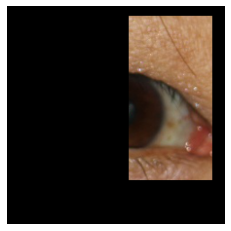

epoch 181
target: 17.0, output: 12.73746395111084
time: 62.6 sec



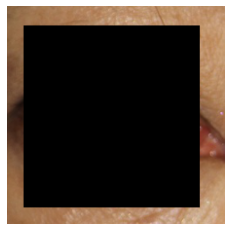

epoch 182
target: 17.0, output: 7.160786151885986
time: 62.7 sec


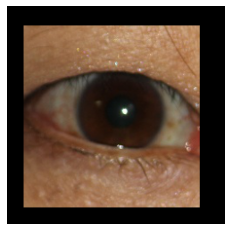

epoch 182
target: 17.0, output: 16.154590606689453
time: 62.9 sec

attention renewed!! (43)



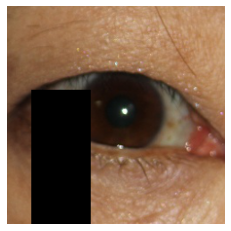

epoch 183
target: 17.0, output: 16.39718246459961
time: 63.0 sec


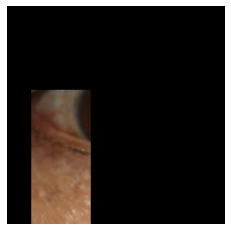

epoch 183
target: 17.0, output: 4.487127304077148
time: 63.2 sec



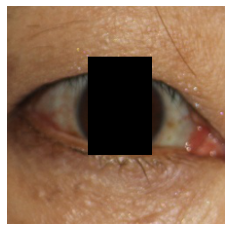

epoch 184
target: 17.0, output: 18.994367599487305
time: 63.3 sec


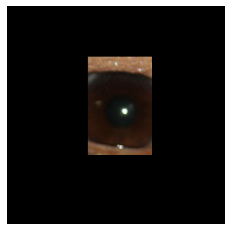

epoch 184
target: 17.0, output: 12.895108222961426
time: 63.5 sec



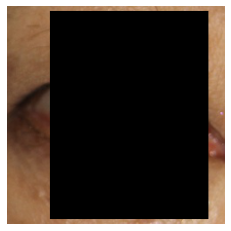

epoch 185
target: 17.0, output: 1.551770567893982
time: 63.6 sec


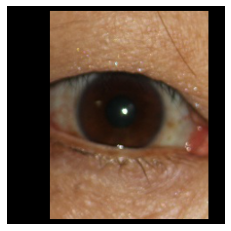

epoch 185
target: 17.0, output: 16.757415771484375
time: 63.8 sec

attention renewed!! (44)



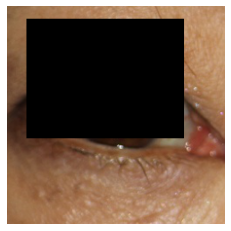

epoch 186
target: 17.0, output: 12.799882888793945
time: 64.0 sec


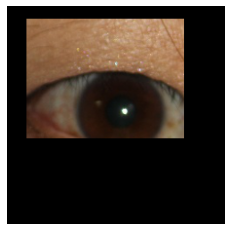

epoch 186
target: 17.0, output: 15.520387649536133
time: 64.2 sec

attention renewed!! (45)



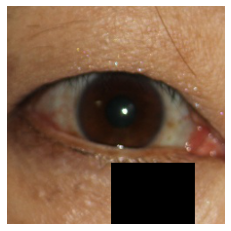

epoch 187
target: 17.0, output: 17.108909606933594
time: 64.4 sec


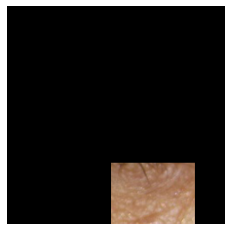

epoch 187
target: 17.0, output: 2.642986297607422
time: 64.6 sec



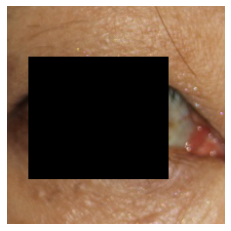

epoch 188
target: 17.0, output: 18.668367385864258
time: 64.7 sec


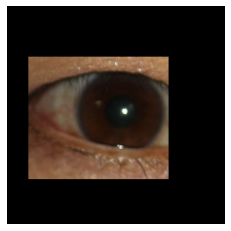

epoch 188
target: 17.0, output: 14.606693267822266
time: 64.9 sec



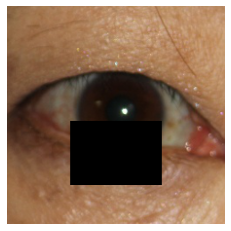

epoch 189
target: 17.0, output: 18.602909088134766
time: 65.0 sec


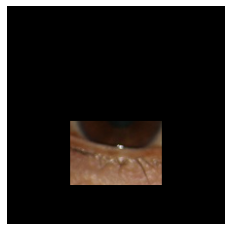

epoch 189
target: 17.0, output: 13.546435356140137
time: 65.2 sec



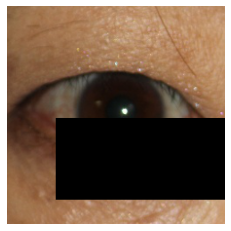

epoch 190
target: 17.0, output: 14.533907890319824
time: 65.3 sec


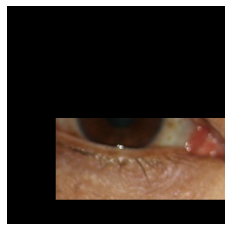

epoch 190
target: 17.0, output: 14.628480911254883
time: 65.5 sec

attention renewed!! (46)



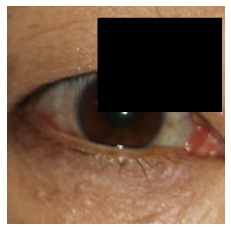

epoch 191
target: 17.0, output: 16.366744995117188
time: 65.6 sec


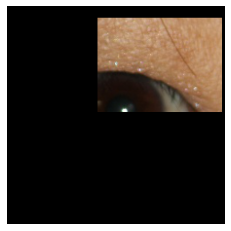

epoch 191
target: 17.0, output: 11.952433586120605
time: 65.8 sec



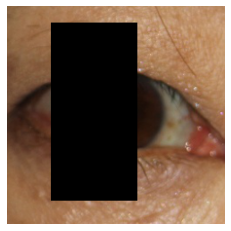

epoch 192
target: 17.0, output: 18.32551383972168
time: 65.9 sec


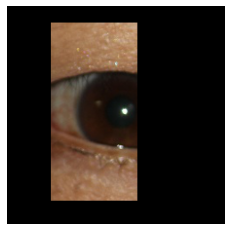

epoch 192
target: 17.0, output: 12.973072052001953
time: 66.1 sec



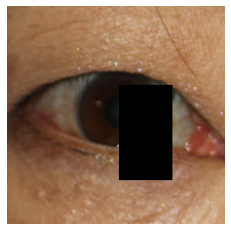

epoch 193
target: 17.0, output: 21.738943099975586
time: 66.3 sec


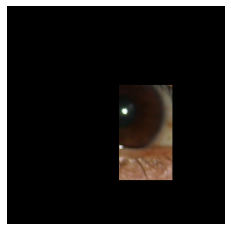

epoch 193
target: 17.0, output: 13.856310844421387
time: 66.4 sec

attention renewed!! (47)



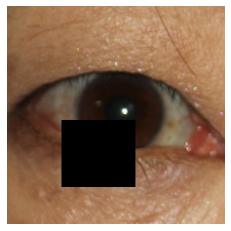

epoch 194
target: 17.0, output: 18.312406539916992
time: 66.6 sec


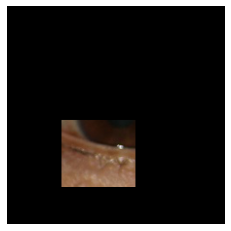

epoch 194
target: 17.0, output: 9.82373046875
time: 66.7 sec



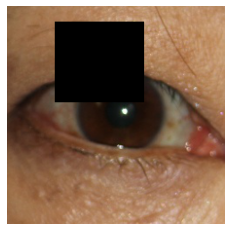

epoch 195
target: 17.0, output: 16.27659034729004
time: 66.9 sec


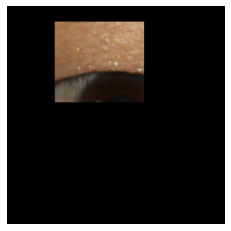

epoch 195
target: 17.0, output: 4.823920249938965
time: 67.0 sec



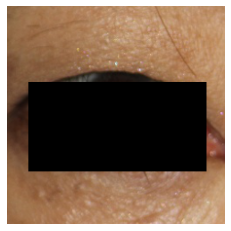

epoch 196
target: 17.0, output: 17.28169059753418
time: 67.2 sec


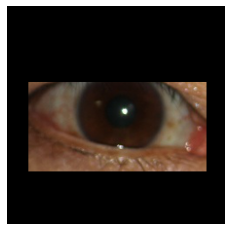

epoch 196
target: 17.0, output: 16.0728759765625
time: 67.3 sec

attention renewed!! (48)



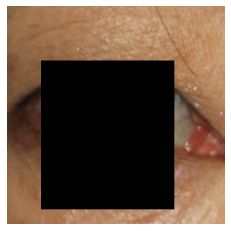

epoch 197
target: 17.0, output: 13.854988098144531
time: 67.5 sec


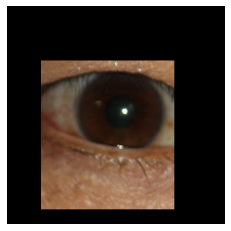

epoch 197
target: 17.0, output: 15.184569358825684
time: 67.6 sec

attention renewed!! (49)



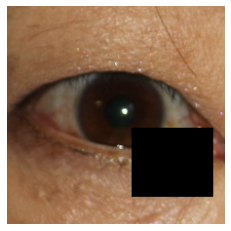

epoch 198
target: 17.0, output: 16.1462459564209
time: 67.8 sec


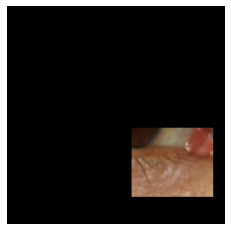

epoch 198
target: 17.0, output: 7.514907360076904
time: 67.9 sec



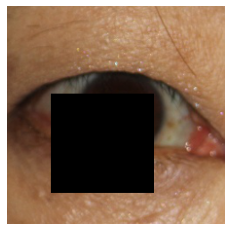

epoch 199
target: 17.0, output: 19.216005325317383
time: 68.1 sec


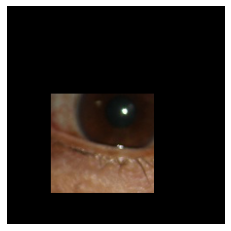

epoch 199
target: 17.0, output: 13.672523498535156
time: 68.3 sec



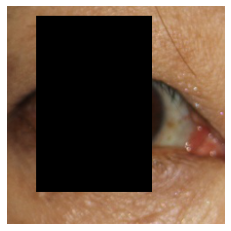

epoch 200
target: 17.0, output: 15.412175178527832
time: 68.4 sec


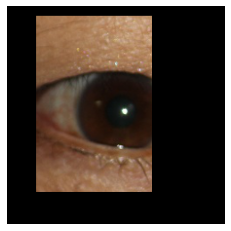

epoch 200
target: 17.0, output: 14.026039123535156
time: 68.6 sec



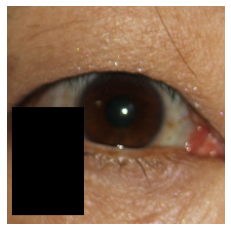

epoch 201
target: 17.0, output: 16.499996185302734
time: 68.7 sec


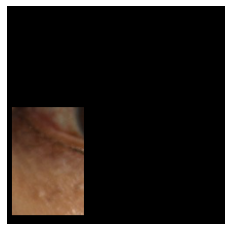

epoch 201
target: 17.0, output: 1.4756088256835938
time: 68.9 sec



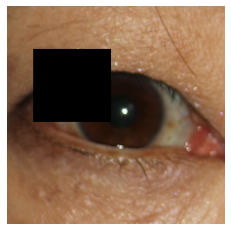

epoch 202
target: 17.0, output: 17.121213912963867
time: 69.1 sec


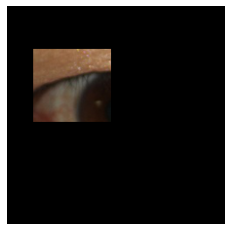

epoch 202
target: 17.0, output: 5.384603977203369
time: 69.2 sec



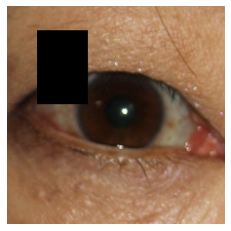

epoch 203
target: 17.0, output: 17.069807052612305
time: 69.4 sec


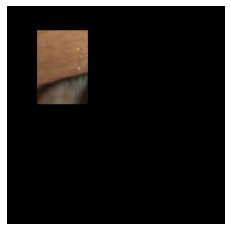

epoch 203
target: 17.0, output: 1.5309913158416748
time: 69.6 sec



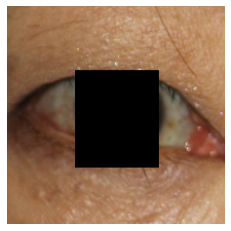

epoch 204
target: 17.0, output: 18.725337982177734
time: 69.7 sec


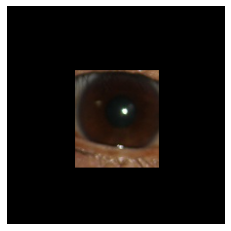

epoch 204
target: 17.0, output: 14.168950080871582
time: 70.0 sec



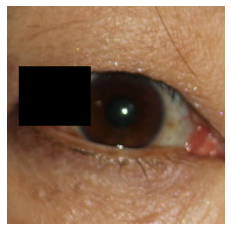

epoch 205
target: 17.0, output: 17.264179229736328
time: 70.2 sec


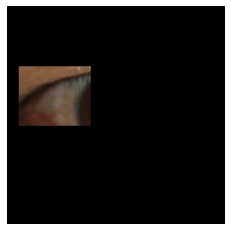

epoch 205
target: 17.0, output: 5.866508483886719
time: 70.3 sec



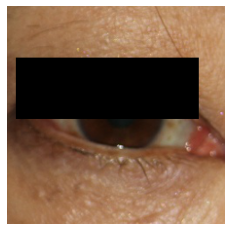

epoch 206
target: 17.0, output: 18.325252532958984
time: 70.5 sec


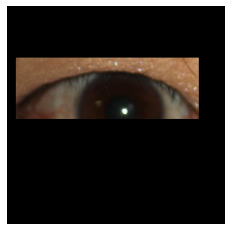

epoch 206
target: 17.0, output: 12.92082405090332
time: 70.7 sec



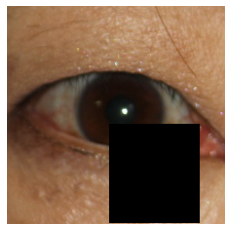

epoch 207
target: 17.0, output: 14.972747802734375
time: 70.8 sec


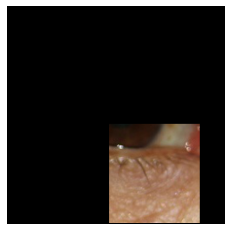

epoch 207
target: 17.0, output: 10.51731014251709
time: 71.0 sec



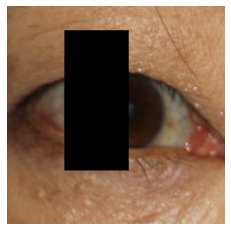

epoch 208
target: 17.0, output: 18.52579689025879
time: 71.2 sec


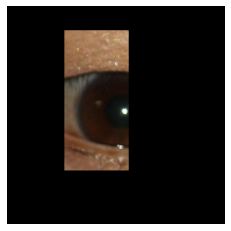

epoch 208
target: 17.0, output: 12.844449996948242
time: 71.3 sec



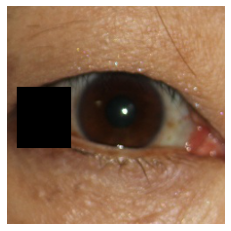

epoch 209
target: 17.0, output: 16.519550323486328
time: 71.5 sec


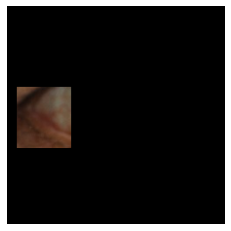

epoch 209
target: 17.0, output: 5.3097920417785645
time: 71.6 sec



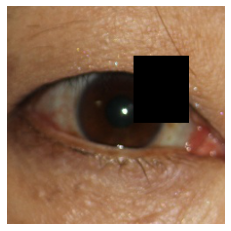

epoch 210
target: 17.0, output: 16.358516693115234
time: 71.8 sec


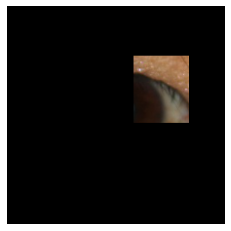

epoch 210
target: 17.0, output: 7.240480899810791
time: 72.0 sec



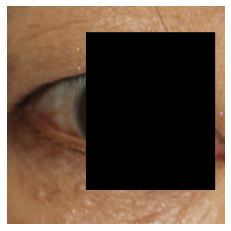

epoch 211
target: 17.0, output: 11.63912582397461
time: 72.1 sec


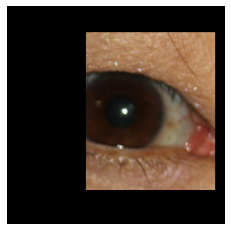

epoch 211
target: 17.0, output: 14.93006706237793
time: 72.3 sec

attention renewed!! (50)



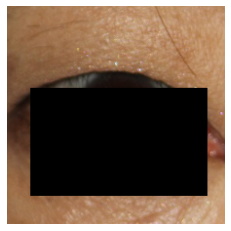

epoch 212
target: 17.0, output: 13.128040313720703
time: 72.4 sec


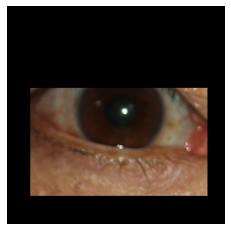

epoch 212
target: 17.0, output: 16.05779457092285
time: 72.6 sec

attention renewed!! (51)



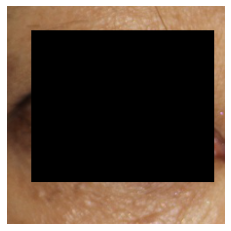

epoch 213
target: 17.0, output: 12.808940887451172
time: 72.8 sec


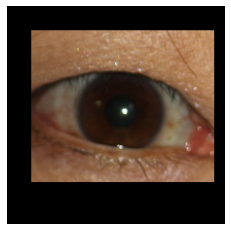

epoch 213
target: 17.0, output: 15.504186630249023
time: 72.9 sec

attention renewed!! (52)



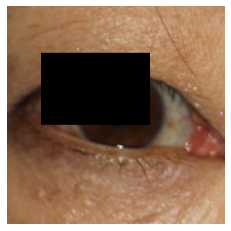

epoch 214
target: 17.0, output: 18.0053768157959
time: 73.1 sec


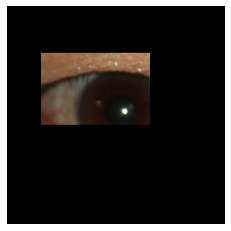

epoch 214
target: 17.0, output: 11.30394172668457
time: 73.2 sec



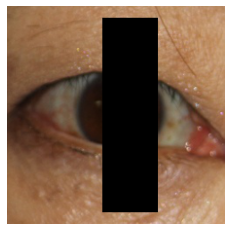

epoch 215
target: 17.0, output: 15.971829414367676
time: 73.4 sec


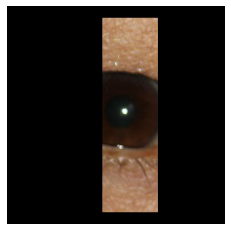

epoch 215
target: 17.0, output: 12.837004661560059
time: 73.5 sec



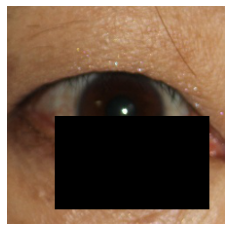

epoch 216
target: 17.0, output: 13.776327133178711
time: 73.7 sec


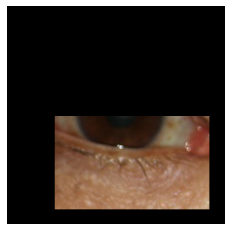

epoch 216
target: 17.0, output: 14.699050903320312
time: 73.8 sec

attention renewed!! (53)



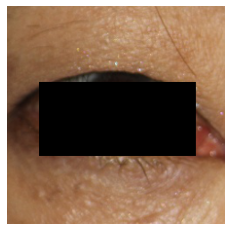

epoch 217
target: 17.0, output: 19.20042610168457
time: 74.0 sec


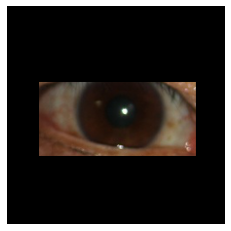

epoch 217
target: 17.0, output: 15.507568359375
time: 74.1 sec

attention renewed!! (54)



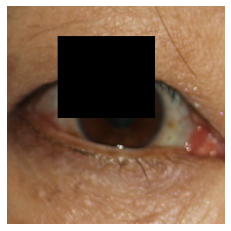

epoch 218
target: 17.0, output: 17.648046493530273
time: 74.3 sec


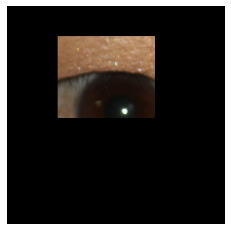

epoch 218
target: 17.0, output: 10.383859634399414
time: 74.4 sec



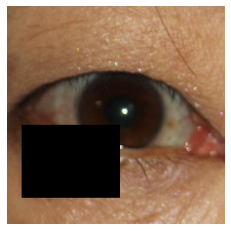

epoch 219
target: 17.0, output: 18.728776931762695
time: 74.6 sec


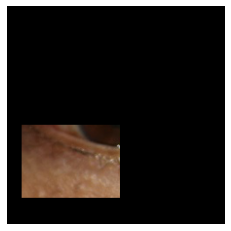

epoch 219
target: 17.0, output: 6.758329391479492
time: 74.8 sec



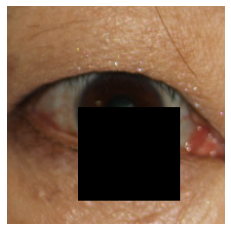

epoch 220
target: 17.0, output: 18.02681541442871
time: 74.9 sec


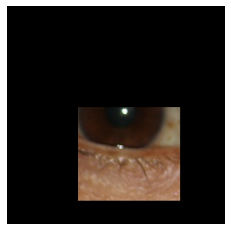

epoch 220
target: 17.0, output: 15.606929779052734
time: 75.1 sec

attention renewed!! (55)



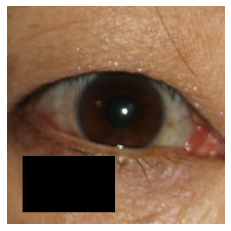

epoch 221
target: 17.0, output: 16.992372512817383
time: 75.3 sec


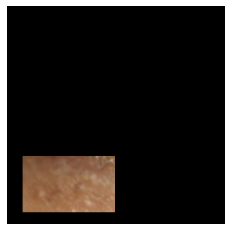

epoch 221
target: 17.0, output: 1.8161115646362305
time: 75.4 sec



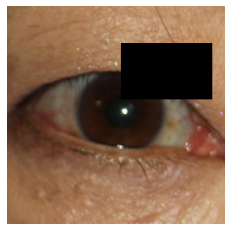

epoch 222
target: 17.0, output: 17.314908981323242
time: 75.6 sec


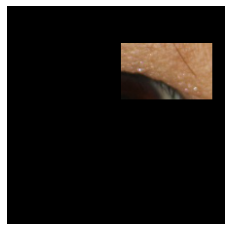

epoch 222
target: 17.0, output: 3.1188628673553467
time: 75.8 sec



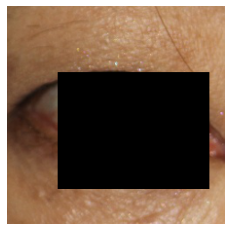

epoch 223
target: 17.0, output: 15.491135597229004
time: 76.0 sec


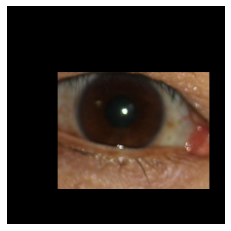

epoch 223
target: 17.0, output: 15.159990310668945
time: 76.1 sec



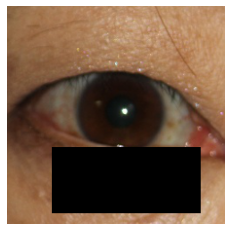

epoch 224
target: 17.0, output: 15.912496566772461
time: 76.3 sec


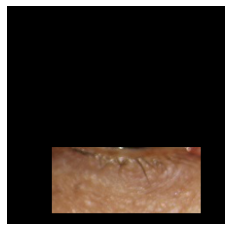

epoch 224
target: 17.0, output: 7.5024237632751465
time: 76.5 sec



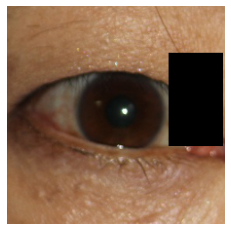

epoch 225
target: 17.0, output: 17.760852813720703
time: 76.6 sec


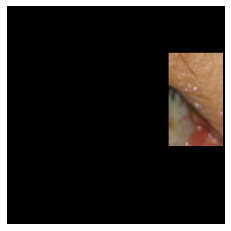

epoch 225
target: 17.0, output: 3.5529286861419678
time: 76.8 sec



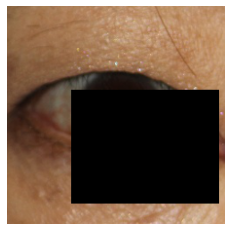

epoch 226
target: 17.0, output: 13.044929504394531
time: 76.9 sec


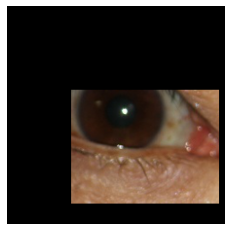

epoch 226
target: 17.0, output: 15.532658576965332
time: 77.1 sec

attention renewed!! (56)



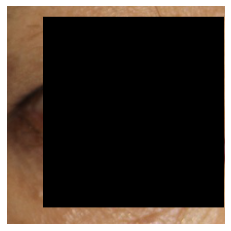

epoch 227
target: 17.0, output: 3.686382532119751
time: 77.3 sec


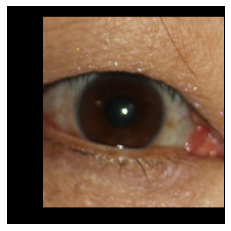

epoch 227
target: 17.0, output: 16.922405242919922
time: 77.4 sec

attention renewed!! (57)



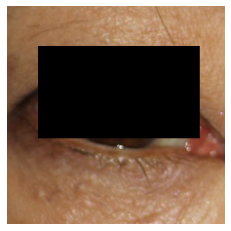

epoch 228
target: 17.0, output: 19.615798950195312
time: 77.6 sec


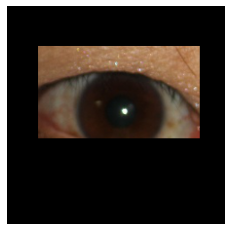

epoch 228
target: 17.0, output: 14.756460189819336
time: 77.7 sec

attention renewed!! (58)



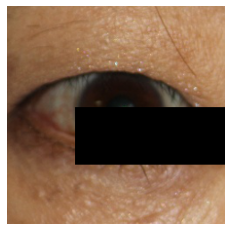

epoch 229
target: 17.0, output: 19.251018524169922
time: 77.9 sec


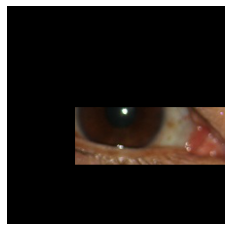

epoch 229
target: 17.0, output: 15.422992706298828
time: 78.0 sec

attention renewed!! (59)



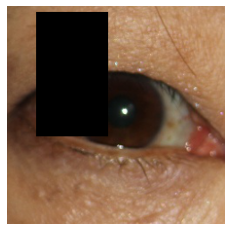

epoch 230
target: 17.0, output: 16.360193252563477
time: 78.2 sec


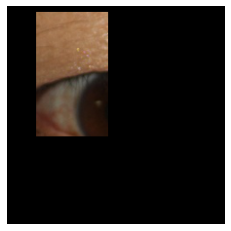

epoch 230
target: 17.0, output: 10.27335262298584
time: 78.3 sec



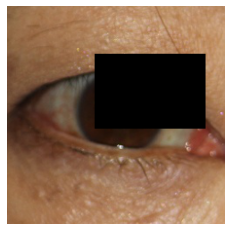

epoch 231
target: 17.0, output: 18.920618057250977
time: 78.5 sec


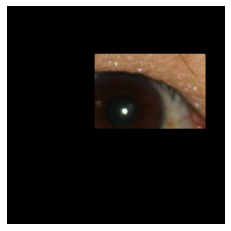

epoch 231
target: 17.0, output: 12.836730003356934
time: 78.7 sec



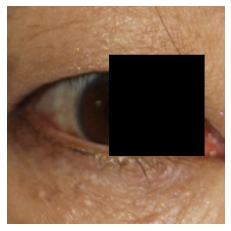

epoch 232
target: 17.0, output: 20.665254592895508
time: 78.8 sec


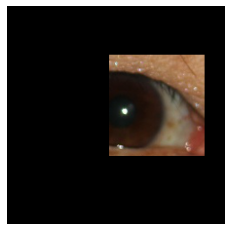

epoch 232
target: 17.0, output: 14.372854232788086
time: 79.0 sec

attention renewed!! (60)



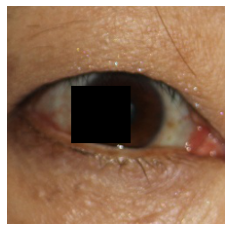

epoch 233
target: 17.0, output: 18.162790298461914
time: 79.2 sec


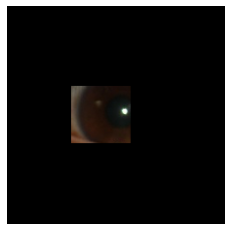

epoch 233
target: 17.0, output: 12.415254592895508
time: 79.3 sec



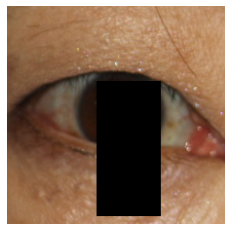

epoch 234
target: 17.0, output: 17.11594581604004
time: 79.5 sec


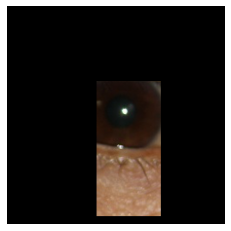

epoch 234
target: 17.0, output: 13.375895500183105
time: 79.6 sec



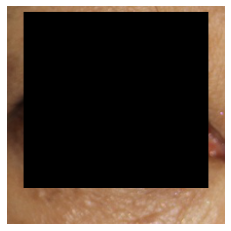

epoch 235
target: 17.0, output: 4.558385372161865
time: 79.8 sec


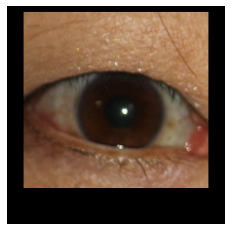

epoch 235
target: 17.0, output: 16.334566116333008
time: 80.0 sec

attention renewed!! (61)



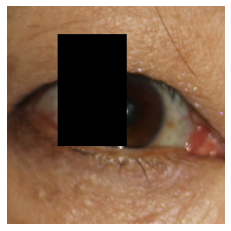

epoch 236
target: 17.0, output: 18.626941680908203
time: 80.1 sec


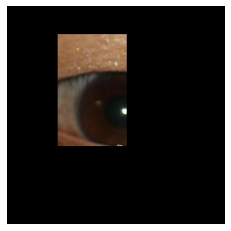

epoch 236
target: 17.0, output: 12.973630905151367
time: 80.3 sec



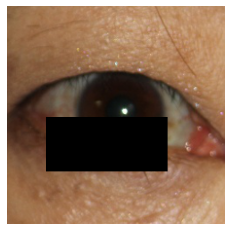

epoch 237
target: 17.0, output: 17.7489013671875
time: 80.5 sec


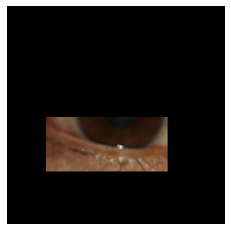

epoch 237
target: 17.0, output: 14.039386749267578
time: 80.6 sec



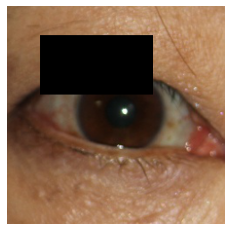

epoch 238
target: 17.0, output: 17.1545352935791
time: 80.8 sec


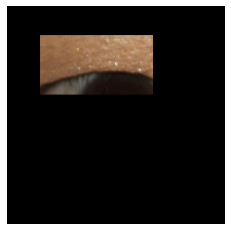

epoch 238
target: 17.0, output: 5.351625442504883
time: 80.9 sec



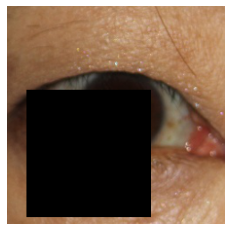

epoch 239
target: 17.0, output: 13.343124389648438
time: 81.1 sec


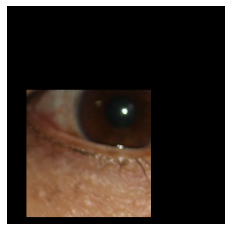

epoch 239
target: 17.0, output: 13.327313423156738
time: 81.2 sec



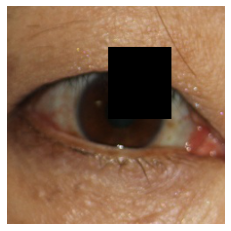

epoch 240
target: 17.0, output: 17.3997745513916
time: 81.4 sec


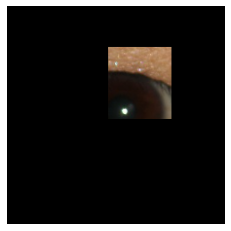

epoch 240
target: 17.0, output: 9.932586669921875
time: 81.7 sec



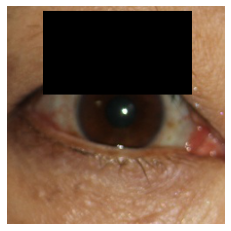

epoch 241
target: 17.0, output: 15.960521697998047
time: 81.8 sec


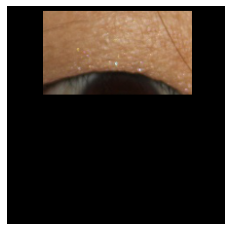

epoch 241
target: 17.0, output: 8.236002922058105
time: 82.0 sec



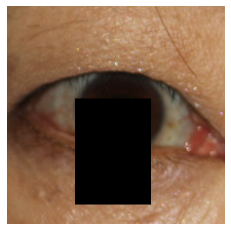

epoch 242
target: 17.0, output: 17.84813690185547
time: 82.2 sec


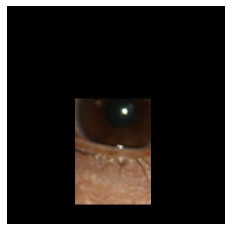

epoch 242
target: 17.0, output: 13.011970520019531
time: 82.3 sec



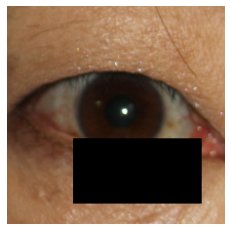

epoch 243
target: 17.0, output: 15.877756118774414
time: 82.5 sec


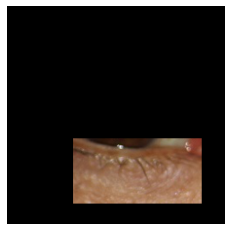

epoch 243
target: 17.0, output: 11.389179229736328
time: 82.6 sec



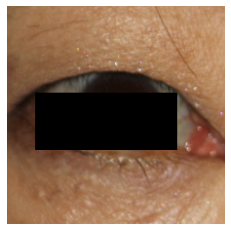

epoch 244
target: 17.0, output: 19.274425506591797
time: 82.8 sec


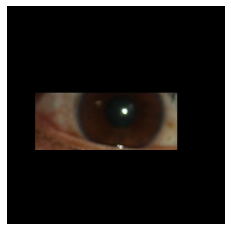

epoch 244
target: 17.0, output: 14.840880393981934
time: 82.9 sec

attention renewed!! (62)



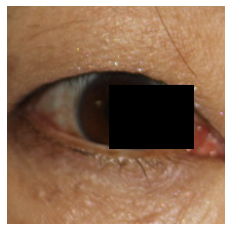

epoch 245
target: 17.0, output: 20.878849029541016
time: 83.1 sec


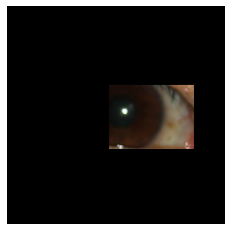

epoch 245
target: 17.0, output: 14.35375690460205
time: 83.2 sec

attention renewed!! (63)



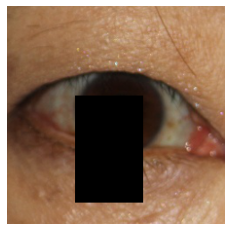

epoch 246
target: 17.0, output: 20.157323837280273
time: 83.4 sec


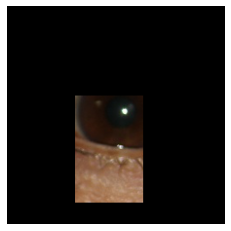

epoch 246
target: 17.0, output: 12.657461166381836
time: 83.5 sec



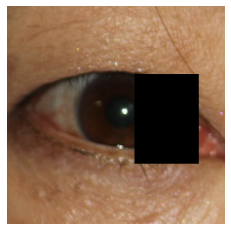

epoch 247
target: 17.0, output: 18.211135864257812
time: 83.7 sec


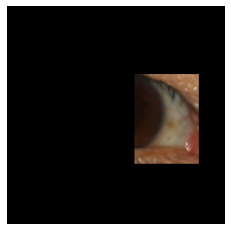

epoch 247
target: 17.0, output: 10.972328186035156
time: 83.9 sec



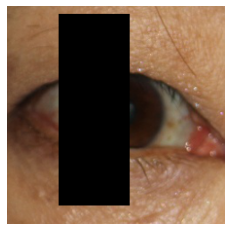

epoch 248
target: 17.0, output: 16.590749740600586
time: 84.0 sec


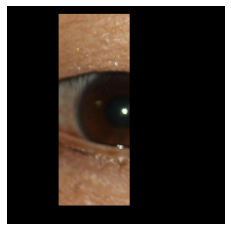

epoch 248
target: 17.0, output: 12.614034652709961
time: 84.2 sec



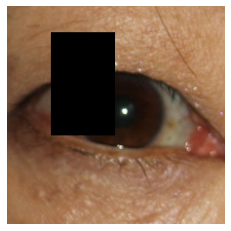

epoch 249
target: 17.0, output: 16.878215789794922
time: 84.3 sec


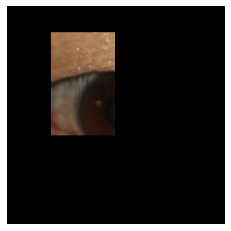

epoch 249
target: 17.0, output: 10.346771240234375
time: 84.5 sec



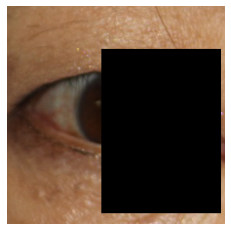

epoch 250
target: 17.0, output: 14.445755004882812
time: 84.6 sec


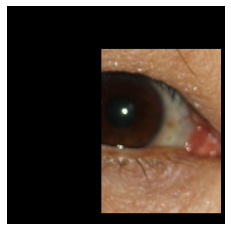

epoch 250
target: 17.0, output: 14.168647766113281
time: 84.8 sec



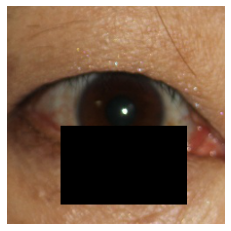

epoch 251
target: 17.0, output: 16.85629653930664
time: 85.0 sec


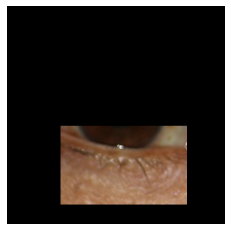

epoch 251
target: 17.0, output: 15.16489028930664
time: 85.1 sec



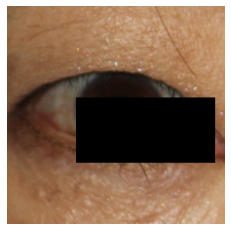

epoch 252
target: 17.0, output: 17.280160903930664
time: 85.3 sec


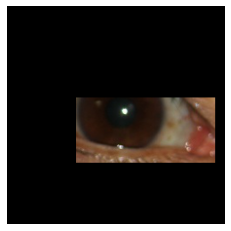

epoch 252
target: 17.0, output: 15.357405662536621
time: 85.4 sec



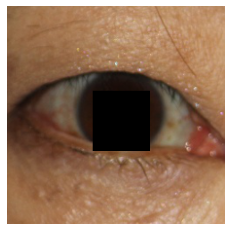

epoch 253
target: 17.0, output: 19.226856231689453
time: 85.6 sec


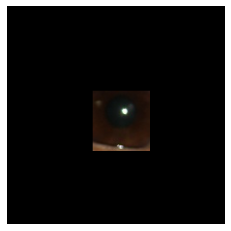

epoch 253
target: 17.0, output: 13.092706680297852
time: 85.7 sec



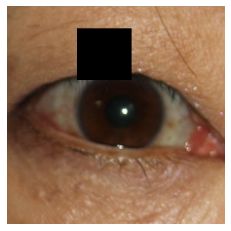

epoch 254
target: 17.0, output: 16.654924392700195
time: 85.9 sec


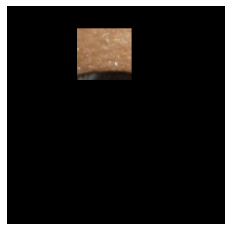

epoch 254
target: 17.0, output: 2.570794105529785
time: 86.1 sec



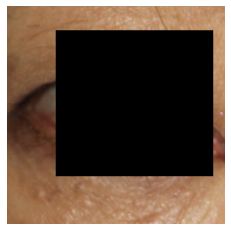

epoch 255
target: 17.0, output: 12.61693000793457
time: 86.2 sec


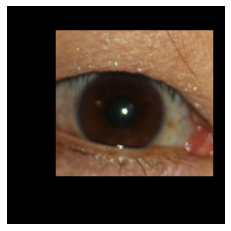

epoch 255
target: 17.0, output: 15.486818313598633
time: 86.4 sec

attention renewed!! (64)



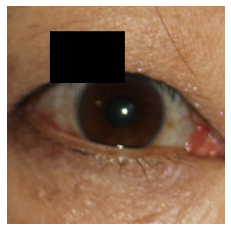

epoch 256
target: 17.0, output: 17.255569458007812
time: 86.6 sec


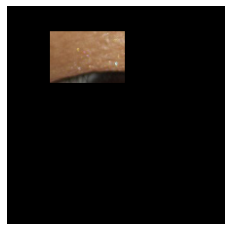

epoch 256
target: 17.0, output: 4.038039684295654
time: 86.7 sec



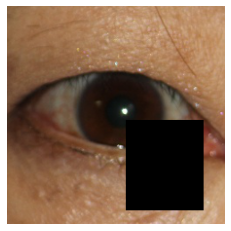

epoch 257
target: 17.0, output: 15.688192367553711
time: 86.9 sec


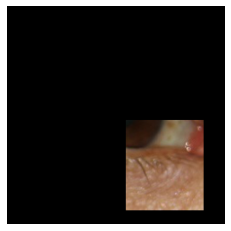

epoch 257
target: 17.0, output: 9.005037307739258
time: 87.0 sec



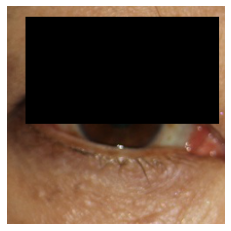

epoch 258
target: 17.0, output: 13.251164436340332
time: 87.2 sec


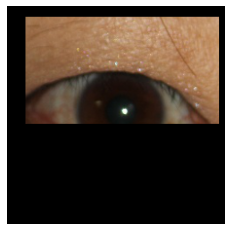

epoch 258
target: 17.0, output: 14.120502471923828
time: 87.4 sec

attention renewed!! (65)



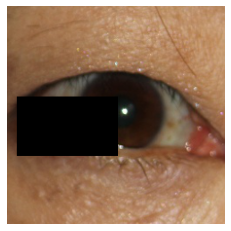

epoch 259
target: 17.0, output: 17.174972534179688
time: 87.6 sec


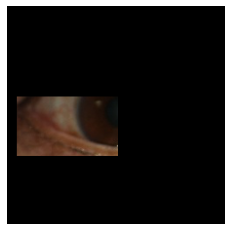

epoch 259
target: 17.0, output: 11.876615524291992
time: 87.8 sec



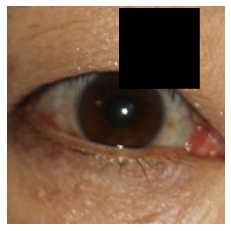

epoch 260
target: 17.0, output: 16.04388427734375
time: 88.0 sec


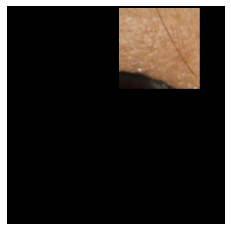

epoch 260
target: 17.0, output: 4.145712852478027
time: 88.1 sec



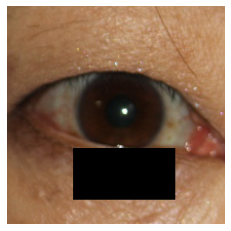

epoch 261
target: 17.0, output: 17.176342010498047
time: 88.3 sec


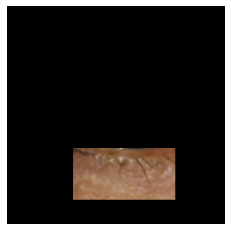

epoch 261
target: 17.0, output: 7.199643135070801
time: 88.4 sec



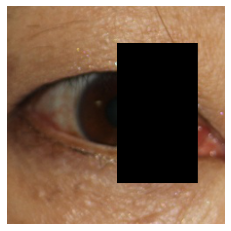

epoch 262
target: 17.0, output: 20.41950035095215
time: 88.6 sec


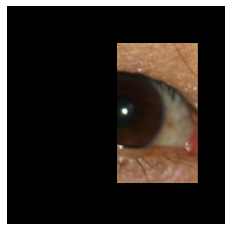

epoch 262
target: 17.0, output: 14.027935981750488
time: 88.7 sec

attention renewed!! (66)



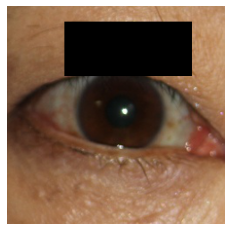

epoch 263
target: 17.0, output: 15.803299903869629
time: 88.9 sec


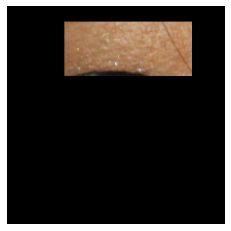

epoch 263
target: 17.0, output: 6.111247539520264
time: 89.1 sec



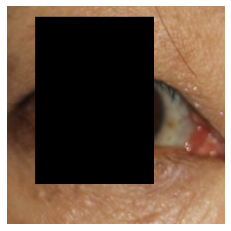

epoch 264
target: 17.0, output: 14.244573593139648
time: 89.2 sec


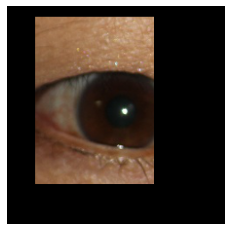

epoch 264
target: 17.0, output: 14.652588844299316
time: 89.4 sec

attention renewed!! (67)



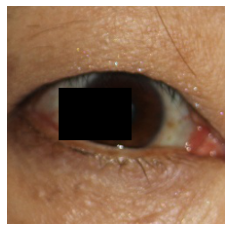

epoch 265
target: 17.0, output: 17.60150146484375
time: 89.9 sec


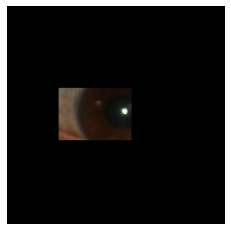

epoch 265
target: 17.0, output: 12.7574462890625
time: 90.0 sec



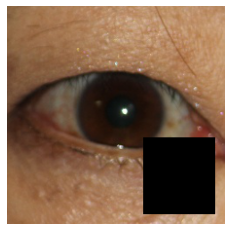

epoch 266
target: 17.0, output: 16.520729064941406
time: 90.2 sec


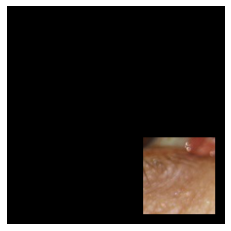

epoch 266
target: 17.0, output: 5.758266925811768
time: 90.3 sec



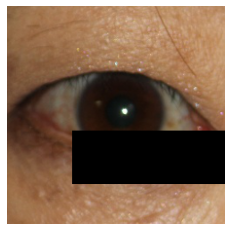

epoch 267
target: 17.0, output: 15.606270790100098
time: 90.7 sec


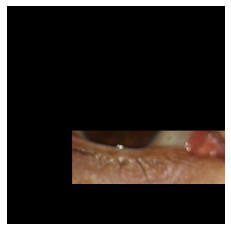

epoch 267
target: 17.0, output: 12.216156005859375
time: 91.0 sec



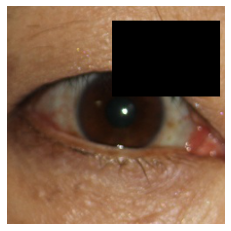

epoch 268
target: 17.0, output: 16.188148498535156
time: 91.1 sec


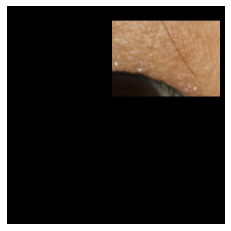

epoch 268
target: 17.0, output: 5.034541606903076
time: 91.3 sec



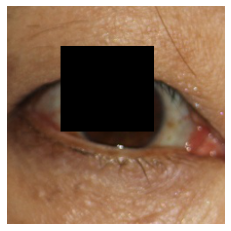

epoch 269
target: 17.0, output: 17.876344680786133
time: 91.5 sec


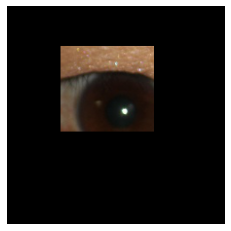

epoch 269
target: 17.0, output: 11.881479263305664
time: 91.7 sec



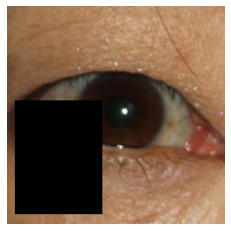

epoch 270
target: 17.0, output: 16.34171485900879
time: 92.1 sec


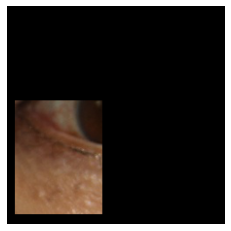

epoch 270
target: 17.0, output: 7.667062282562256
time: 92.2 sec



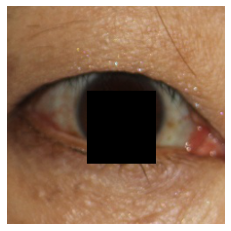

epoch 271
target: 17.0, output: 19.70780372619629
time: 92.4 sec


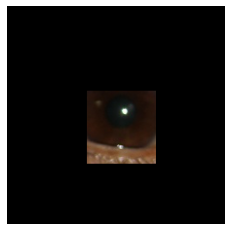

epoch 271
target: 17.0, output: 14.300507545471191
time: 92.5 sec

attention renewed!! (68)



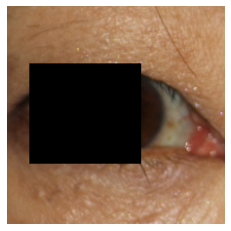

epoch 272
target: 17.0, output: 19.577999114990234
time: 92.7 sec


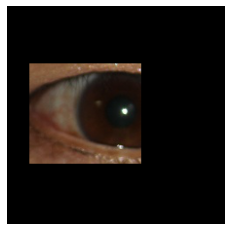

epoch 272
target: 17.0, output: 13.968154907226562
time: 92.8 sec

attention renewed!! (69)



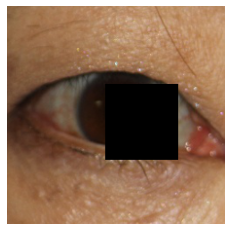

epoch 273
target: 17.0, output: 20.49788475036621
time: 93.0 sec


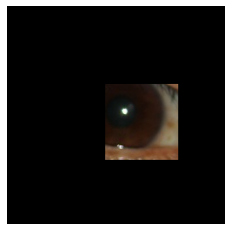

epoch 273
target: 17.0, output: 14.418947219848633
time: 93.1 sec

attention renewed!! (70)



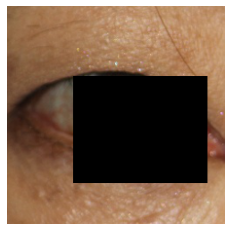

epoch 274
target: 17.0, output: 16.50439453125
time: 93.3 sec


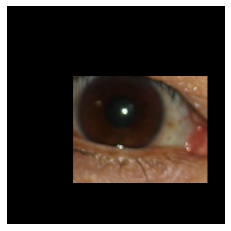

epoch 274
target: 17.0, output: 14.693342208862305
time: 93.4 sec



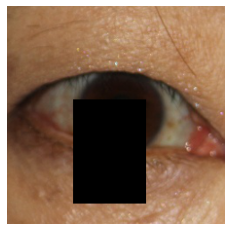

epoch 275
target: 17.0, output: 19.58370590209961
time: 93.6 sec


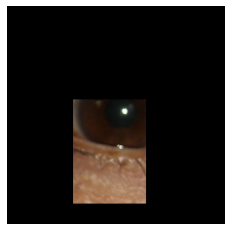

epoch 275
target: 17.0, output: 12.772723197937012
time: 93.8 sec



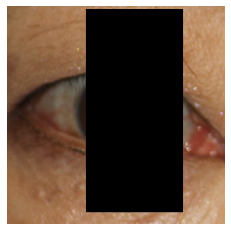

epoch 276
target: 17.0, output: 6.346503734588623
time: 93.9 sec


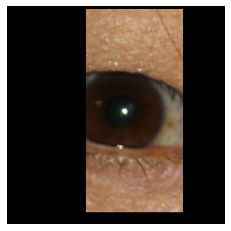

epoch 276
target: 17.0, output: 15.741023063659668
time: 94.2 sec

attention renewed!! (71)



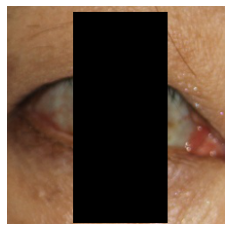

epoch 277
target: 17.0, output: 6.401726245880127
time: 94.4 sec


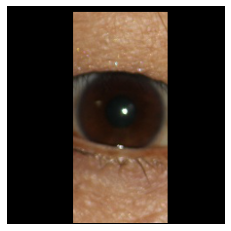

epoch 277
target: 17.0, output: 14.2214994430542
time: 94.5 sec

attention renewed!! (72)



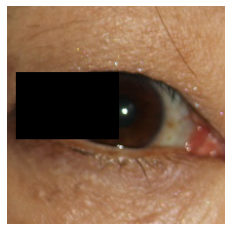

epoch 278
target: 17.0, output: 18.05341148376465
time: 94.7 sec


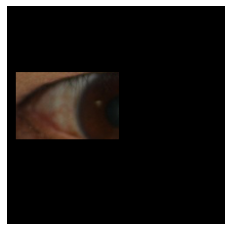

epoch 278
target: 17.0, output: 12.656705856323242
time: 94.9 sec



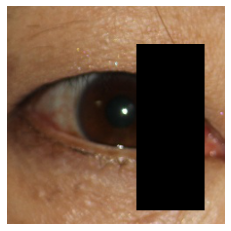

epoch 279
target: 17.0, output: 15.48754596710205
time: 95.0 sec


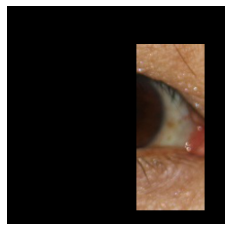

epoch 279
target: 17.0, output: 10.348204612731934
time: 95.2 sec



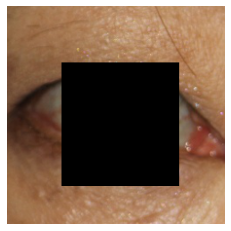

epoch 280
target: 17.0, output: 16.513769149780273
time: 95.3 sec


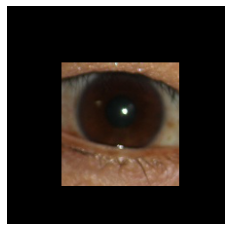

epoch 280
target: 17.0, output: 14.928489685058594
time: 95.5 sec



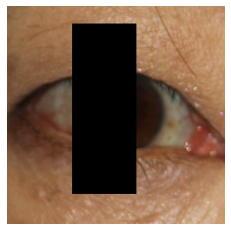

epoch 281
target: 17.0, output: 18.47881507873535
time: 95.7 sec


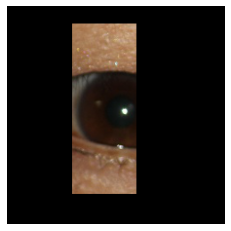

epoch 281
target: 17.0, output: 11.949403762817383
time: 95.8 sec



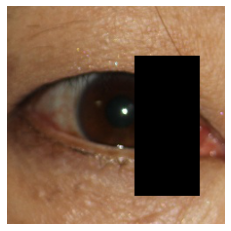

epoch 282
target: 17.0, output: 17.587940216064453
time: 96.0 sec


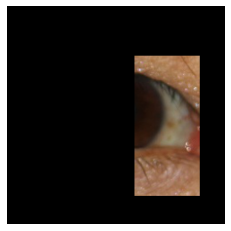

epoch 282
target: 17.0, output: 9.884657859802246
time: 96.1 sec



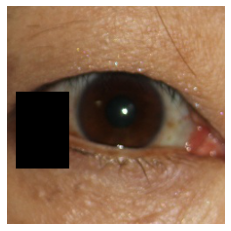

epoch 283
target: 17.0, output: 16.335281372070312
time: 96.3 sec


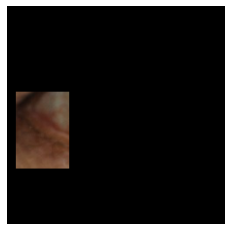

epoch 283
target: 17.0, output: 2.7156858444213867
time: 96.4 sec



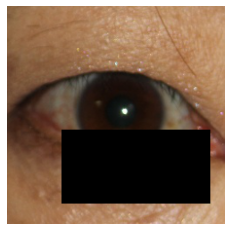

epoch 284
target: 17.0, output: 14.555865287780762
time: 96.6 sec


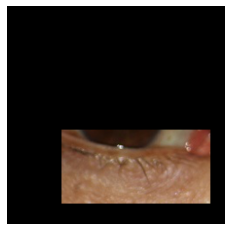

epoch 284
target: 17.0, output: 13.09317398071289
time: 96.7 sec



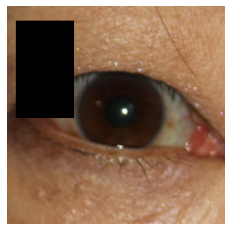

epoch 285
target: 17.0, output: 16.553783416748047
time: 96.9 sec


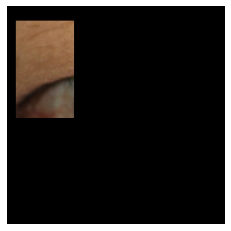

epoch 285
target: 17.0, output: 1.5822457075119019
time: 97.1 sec



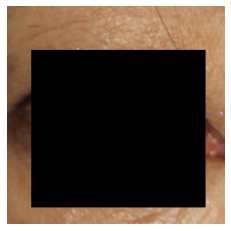

epoch 286
target: 17.0, output: 10.948780059814453
time: 97.2 sec


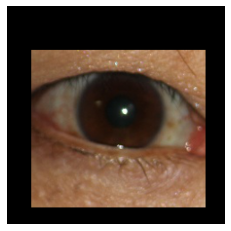

epoch 286
target: 17.0, output: 15.472551345825195
time: 97.4 sec

attention renewed!! (73)



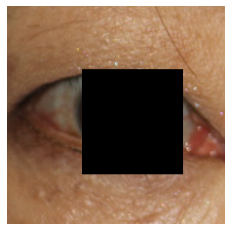

epoch 287
target: 17.0, output: 18.424781799316406
time: 97.6 sec


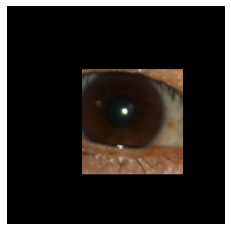

epoch 287
target: 17.0, output: 15.75767707824707
time: 97.7 sec

attention renewed!! (74)



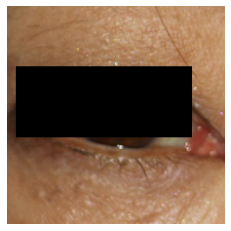

epoch 288
target: 17.0, output: 20.053781509399414
time: 97.9 sec


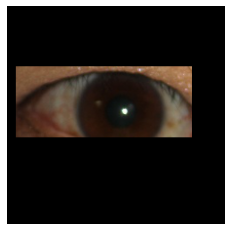

epoch 288
target: 17.0, output: 15.40638542175293
time: 98.0 sec

attention renewed!! (75)



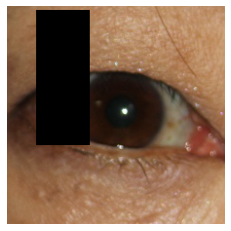

epoch 289
target: 17.0, output: 17.189804077148438
time: 98.2 sec


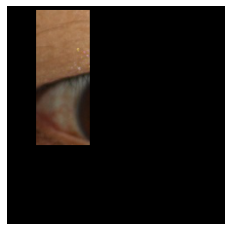

epoch 289
target: 17.0, output: 6.779530048370361
time: 98.3 sec



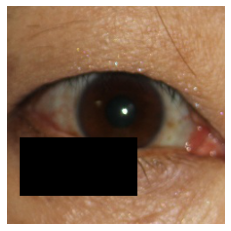

epoch 290
target: 17.0, output: 18.058454513549805
time: 98.5 sec


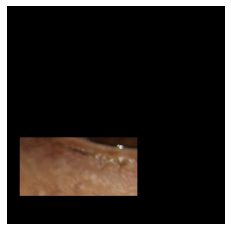

epoch 290
target: 17.0, output: 5.8252105712890625
time: 98.6 sec



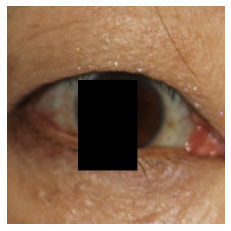

epoch 291
target: 17.0, output: 20.31682777404785
time: 98.8 sec


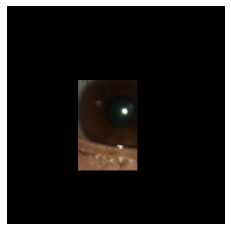

epoch 291
target: 17.0, output: 13.45938777923584
time: 99.0 sec

attention renewed!! (76)



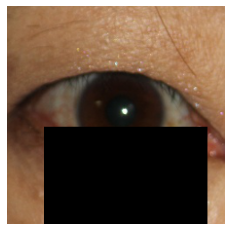

epoch 292
target: 17.0, output: 14.220022201538086
time: 99.1 sec


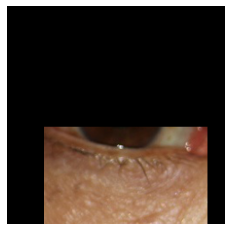

epoch 292
target: 17.0, output: 12.802461624145508
time: 99.3 sec



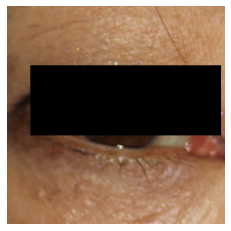

epoch 293
target: 17.0, output: 19.29972267150879
time: 99.5 sec


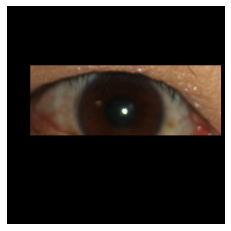

epoch 293
target: 17.0, output: 14.812280654907227
time: 99.6 sec

attention renewed!! (77)



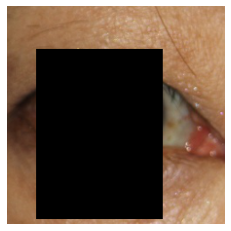

epoch 294
target: 17.0, output: 12.073914527893066
time: 99.8 sec


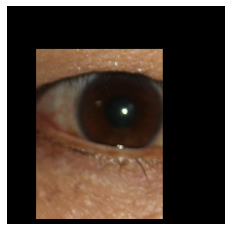

epoch 294
target: 17.0, output: 13.599641799926758
time: 100.1 sec

attention renewed!! (78)



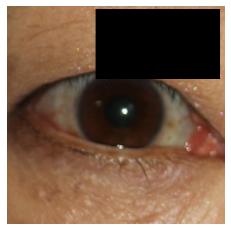

epoch 295
target: 17.0, output: 15.519734382629395
time: 100.2 sec


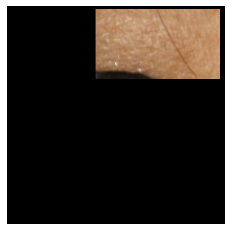

epoch 295
target: 17.0, output: 7.078432559967041
time: 100.4 sec



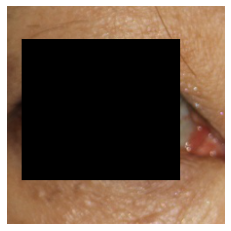

epoch 296
target: 17.0, output: 16.50969886779785
time: 100.6 sec


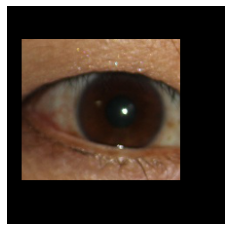

epoch 296
target: 17.0, output: 15.289304733276367
time: 100.7 sec



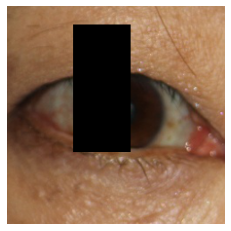

epoch 297
target: 17.0, output: 17.95282554626465
time: 100.9 sec


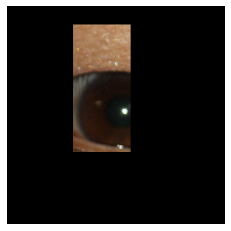

epoch 297
target: 17.0, output: 12.418737411499023
time: 101.0 sec



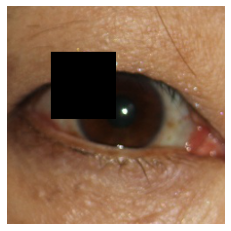

epoch 298
target: 17.0, output: 17.460338592529297
time: 101.2 sec


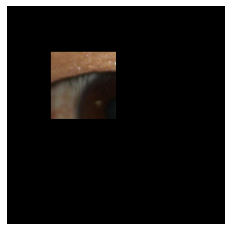

epoch 298
target: 17.0, output: 4.641571998596191
time: 101.3 sec



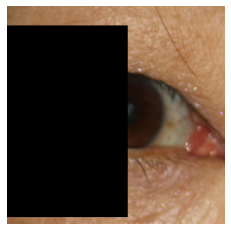

epoch 299
target: 17.0, output: 13.821524620056152
time: 101.5 sec


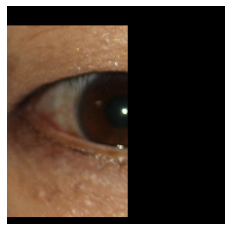

epoch 299
target: 17.0, output: 13.368559837341309
time: 101.6 sec



In [7]:
attention = np.zeros((224, 224), dtype=int)
time_sta = time.time()

renew = 0
for epoch in range(300):
    masked_img = [0]*2
    outputs = []
    masked_img[0], masked_img[1], c = randmask(image) #c:画像内の座標

    for img in masked_img:
          with torch.inference_mode():
              image_tensor = image_transform(img)  
              # forward pass: compute predicted outputs by passing inputs to the model
              outputs.append(model_ft(image_tensor).item()) 

    for i, imgPIL in enumerate(masked_img):
        plt.imshow(imgPIL)
        plt.axis("off")
        plt.show()
        print(f"epoch {epoch}")
        print(f"target: {targets[0]}, output: {outputs[i]}")

        time_end = time.time()
        tim = time_end- time_sta
        print(f"time: {round(tim,1)} sec")

    print("")
    if abs(outputs[0]-orig_output[0]) > abs(outputs[1]-orig_output[0]): #切り抜き画像の精度 > 消去画像の精度の場合
        #square_measure = 50176-(c[2]-c[0])*(c[3]-c[1]) #矩形領域を除いた面積をcoefとする（矩形が小さいほどcoefが大きくなる）
        coef = 1
        attention[c[1]:c[3]+1, c[0]:c[2]+1] += coef*3 #mask内の座標にcoefポイント加算
        attention -= coef #全体から1ポイント減算
        renew += 1
        print(f"attention renewed!! ({renew})")
        print("")

attention_backup = attention

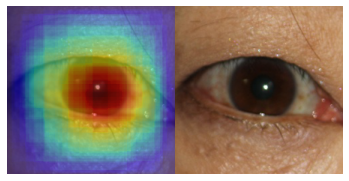

In [10]:
#最大と最小が0と255になるように補正
attention = attention_backup.copy()
min = np.amin(attention)
attention = 255*(attention -np.amin(attention))/(np.amax(attention) - np.amin(attention))
attention = attention.astype(int)
attention

#グラフを1行2列に並べたうちの1番目
plt.subplots_adjust(wspace=0,hspace=0)
plt.subplot(1, 2, 1)
plt.axis('off')
plt.imshow(image)
plt.imshow(np.array(attention), alpha=0.5, cmap='jet')

#元の画像を並べて表示
plt.subplot(1, 2, 2)
plt.axis('off')
plt.imshow(image)

plt.savefig("colormap.png", dpi=300)

plt.show()

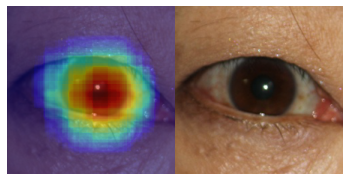

In [9]:
#マイナスを削除した上で、最大と最小が0と255になるように補正
attention = attention_backup.copy()
min = np.amin(attention)
attention[attention < 0] = 0
attention = 255*(attention -np.amin(attention))/(np.amax(attention) - np.amin(attention))
attention = attention.astype(int)

#グラフを1行2列に並べたうちの1番目
plt.subplots_adjust(wspace=0,hspace=0)
plt.subplot(1, 2, 1)
plt.axis('off')
plt.imshow(image)
plt.imshow(np.array(attention), alpha=0.5, cmap='jet')

#元の画像を並べて表示
plt.subplot(1, 2, 2)
plt.axis('off')
plt.imshow(image)

plt.savefig("colormap.png", dpi=300)

plt.show()

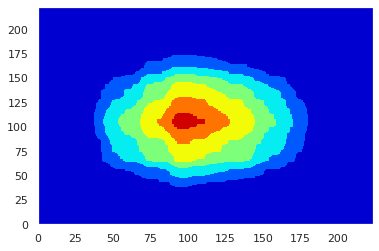

In [13]:
x = np.arange(0,224)
y = np.arange(0,224)
X, Y = np.meshgrid(x, y)
data = attention

plt.contourf(X, Y, data, cmap="jet") #等高線をプロット
plt.show() #画像の表示